# Data Preprocessing & Feature Engineering for Machine Learning - Predicting House Prices in California

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
# importing the image
import matplotlib.image as mpimg 
import numpy as np
import seaborn as sns

# To assess the impact of capped values in median_house_value on the quality of our Random Forest Regressor model
## Splitting the dataset into training and testing sets:
from sklearn.model_selection import train_test_split
## Training the Random Forest Regressor model for continuous target variable
from sklearn.ensemble import RandomForestRegressor
## For both models, we'll evaluate their performance using appropriate metrics like Mean Absolute Error (MAE), 
## Root Mean Squared Error (RMSE), and R-squared (R²) to understand the impact of capped values:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Perform Shapiro-Wilk test to check if features are normally distributed
from scipy import stats

# Create base map
import folium
# Define a custom colormap with distinct colors
from branca.colormap import LinearColormap

# To display Folium map that is saved in an HTML file in the default web browser
import webbrowser

## (1) Project Introduction

In this project, we are going to predict house prices for districts in California by training and testing an appropriate machine learning model on a dataset containing information on more than 20,000 districts in California. We are going to use the Random Forest Regressor model. 

We plan to visualize California on a map where each point represents a district. The median housing prices in these districts will be illustrated using a color gradient.

We will try to understand why some districts are more expensive than others. We will try to find the most important features that determine house prices, for instance, location or median income.

Finally, we are going to train and test a machine learning model with scikit learn that allows us to predict prices for districts where we don't have any information on house prices.

The primary emphasis will be on:

1. The importation and examination of the dataset to ensure its readiness for analysis.
2. Conducting Explanatory Data Analysis with Pandas and Seaborn to understand the data to select and create appropriate features and select an appropriate model.
3. Undertaking data pre-processing and feature engineering using Pandas to prepare the data for modeling.

While integrating these steps into a scikit-learn pre-processing pipeline is common for ongoing machine learning operations, for a one-off project like ours, employing straightforward Pandas code for data manipulation and preparation is equally effective.

## (2) Data Import and Inspection

We are going to import and inspect the California House value dataset containing data for more than 20,000 districts. That's the data that we are going to use to build our machine learning model to predict values for districts where we do not have any information on house values.

In [6]:
df = pd.read_csv("./data/housing.csv")

In [7]:
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


The California House Value dataset comprises 20,640 entries across 10 columns and each and every row stands for a district in California.

And we have ten features:

__Features__:

* **longitude:**  geographic coordinate (district´s east-west position)
* **latitude:**  geographic coordinate (district´s north-south position)
* **housing_median_age:** median age of houses in district
* **total_rooms** Sum of all rooms in district
* **total_bedrooms** Sum of all bedrooms in district
* **population:** total population in district
* **households:** total households in district
* **median_income:** median household income in district. These values are scaled. So this is already scaled and we actually do not know the absolute numbers. So it could be between $\$10,000$ and $\$100,000$ or whatsoever.
* **median_house_value:** median house value in district
* **ocean_proximity:** District´s proximity to the ocean

The term "households" typically refers to the number of separate living quarters within the district where occupants live together, such as families, roommates, or individuals living alone. Each household would generally represent a group of people, often a family, living together in a single housing unit. This could include houses, apartments, or other forms of living spaces where residents share common living arrangements and facilities.

Let's also have a look at some meta information:

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


### (2.1) Initial overview and some cleaning recommendations

<font color="green" size=4>**1. Missing Values**</font>: The `total_bedrooms` feature has 207 missing entries. Considering the context, options for **handling these missing values** include imputing them with the median, mean, or another statistical replacement depending on the distribution, or removing the rows if losing some data doesn't significantly impact the dataset.

<font color="green" size=4>**2. Data Types**</font>: All features except `ocean_proximity` are numerical, with `ocean_proximity` being categorical. For machine learning models, we may need to **convert `ocean_proximity` into a numerical format** using techniques like one-hot encoding.

And we can also have a look at those rows or those districts where we have missing values in the feature `total_bedrooms`.

In [5]:
df.total_bedrooms.isnull().sum()

207

In [6]:
df[df.total_bedrooms.isna()]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
290,-122.16,37.77,47.0,1256.0,NaN,570.0,218.0,4.3750,161900.0,NEAR BAY
341,-122.17,37.75,38.0,992.0,NaN,732.0,259.0,1.6196,85100.0,NEAR BAY
538,-122.28,37.78,29.0,5154.0,NaN,3741.0,1273.0,2.5762,173400.0,NEAR BAY
563,-122.24,37.75,45.0,891.0,NaN,384.0,146.0,4.9489,247100.0,NEAR BAY
696,-122.10,37.69,41.0,746.0,NaN,387.0,161.0,3.9063,178400.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20267,-119.19,34.20,18.0,3620.0,NaN,3171.0,779.0,3.3409,220500.0,NEAR OCEAN
20268,-119.18,34.19,19.0,2393.0,NaN,1938.0,762.0,1.6953,167400.0,NEAR OCEAN
20372,-118.88,34.17,15.0,4260.0,NaN,1701.0,669.0,5.1033,410700.0,<1H OCEAN
20460,-118.75,34.29,17.0,5512.0,NaN,2734.0,814.0,6.6073,258100.0,<1H OCEAN


And we can also check whether we have duplicates with duplicated.

And this is obviously not the case:

In [7]:
df[df.duplicated()]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity


Next, we can also get some summary statistics on the numerical columns:

In [8]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


<font color="green" size=4>**3. Statistical Summary**:</font>
   - **Longitude and Latitude**: These features indicate the geographic location of the districts and do not require cleaning but can be used for spatial visualizations or as features in the model if location is believed to influence house values.
   - **Housing Median Age**: Ranges from 1 to 52 years, which seems reasonable and doesn't suggest the need for cleaning. For instance, the average median age of houses is slightly more than 28 years.
   - **Total Rooms, Total Bedrooms, Population, and Households**: These features show a wide range of values, indicating diverse district sizes and characteristics. For instance, we have populations between only 3 persons and more than 35,000 persons in a district. **We might consider normalizing or standardizing these features for some machine learning algorithms.**
   - **Median Income**: This is a key feature likely influencing house values. Since the values are scaled the mean median_income as approximately 3.8707, this indeed suggests an average median household income of $38,707 across all districts in the dataset.
   - **Median House Value**: For instance, the average median house value is 206,855. This is the target variable, with values ranging widely, indicating a diverse set of house values across districts.

The median income within a district may be considered a key feature likely influencing house values for several reasons grounded in economic principles and historical housing market data:

- **Affordability**: Higher median incomes in a district typically translate to a greater purchasing power among the residents. This increased financial capability allows residents to afford more expensive homes, driving up the median house values in the area.

- **Demand and Supply**: In areas with higher median incomes, the demand for housing can increase as people have more money to spend on housing. According to the basic economic principle of demand and supply, increased demand can lead to higher prices if the supply does not keep pace. Thus, districts with higher median incomes might see an upward pressure on house prices.

- **Lending and Credit Availability**: Individuals and households with higher incomes are generally considered more creditworthy by lenders, enabling them to secure larger mortgages more easily. This can increase their ability to purchase more expensive homes, again potentially driving up house values in districts with higher median incomes.

- **Housing Quality and Amenities**: Districts with higher median incomes often have more resources for public services, amenities, and better-maintained infrastructure, making these areas more desirable places to live. The increased desirability can lead to higher house values.

- **Empirical Evidence**: We should **check correlation between income levels and housing prices** across various geographical locations. We may expect a strong correlation between income levels and housing prices across various geographic locations. Higher median incomes often correlate with higher median house values, making it a significant feature for predicting house prices in machine learning models.

Given these factors, median income may serves as a strong predictor of a district's housing market conditions and is therefore may be considered a critical feature in models predicting house values.

So let's get some more information also on the text column:

In [9]:
df.describe(include = "O")

,ocean_proximity
count,20640
unique,5
top,<1H OCEAN
freq,9136


Count the number of districts according to its proximity to the ocean. For instance, 9136 districts are  less than 1 hour drive from the ocean:

In [10]:
df.ocean_proximity.value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

Below we can count number of districts with total rooms. For instance, 18 districts with total 1527 rooms:

In [11]:
df.total_rooms.value_counts()

total_rooms
1527.0     18
1613.0     17
1582.0     17
2127.0     16
1717.0     15
           ..
9614.0      1
10839.0     1
11872.0     1
6205.0      1
10035.0     1
Name: count, Length: 5926, dtype: int64

<font color="green" size=4>**4. Outliers and Anomalies**</font>: So the value counts method for these numerical columns is not helpful. So it's more useful to create a histograms with 50 bins. By plotting histograms for the numerical features will allow us to inspect for outliers or anomalies that could affect model training:

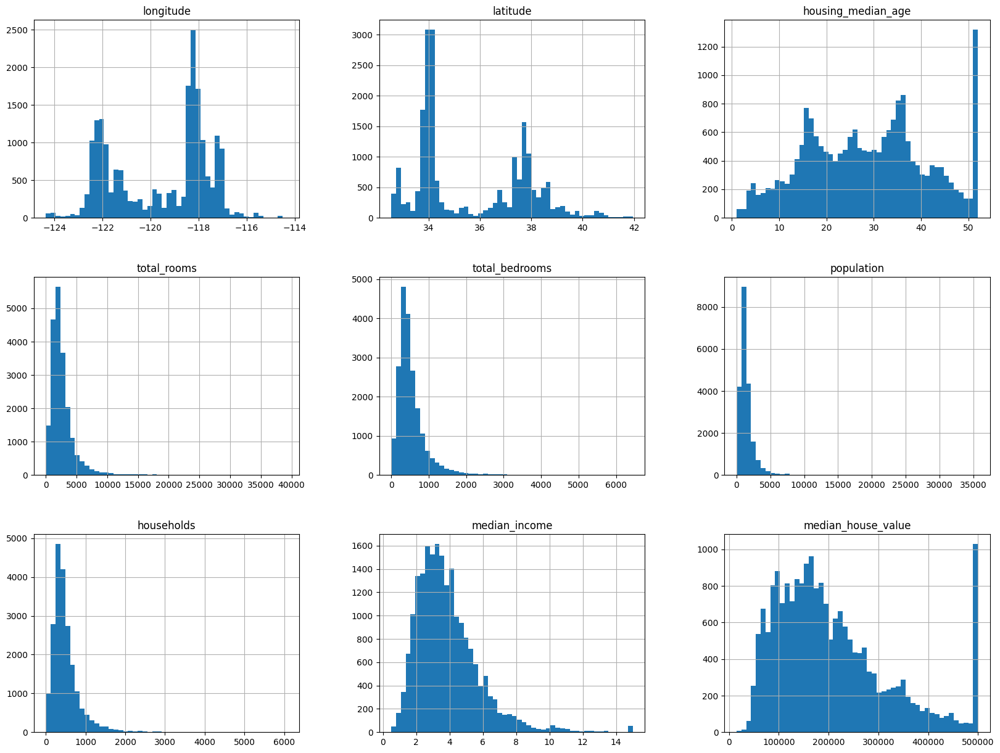

In [12]:
df.hist(bins=50, figsize=(20,15))
plt.show()

[See how to plot the same histograms in Seaborn](./support_files/descriptive_stats.ipynb)

In [13]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


**`Analysis of Histograms:`**

- **`The households`**, we can see that we have some extreme values here on the right-hand side. So we have very few districts where we have 5000 or even 6000 households, but actually, the typical value is around 500.

- **`The housing_median_age`**, we can observe bimodal or even multimodal distribution. Three prominent picks suggest three age groups where a large number of districts have their median housing age. You can see two picks of approximately the same size, one at around 17 years and another at around 37 years, meaning relatively new house and another group with much older houses. In the middle, there is a small third pick at around 27 years. And then there is the biggest the fourth pick at 52 years. These peaks may correspond to periods of development boom. The peaks might also represent regional differences in development within the state.

- **`The latitude and the longitude`**. Bimodal distributions in histograms for longitude and latitude indicate two primary concentrations of districts within the dataset based on their geographic locations. The bimodal distribution implies that the districts are not evenly spread across California but instead tend to cluster around two main areas. These could correspond to major urban centers, specific geographic features, or areas of significant economic activity.

- **`The median_house_value`**, the distribution shows a spike at the high end of the value range, around $500,000. This spike confirms the presence of capped values in the dataset. Besides this, the distribution is fairly continuous, indicating a wide range of house values across California districts. We may check if thi spike can present a problem for our model.

- **`The median_ income`**, the distribution of median income is less skewed than the `total_rooms` or `population`, but it still shows some right skewness. This indicates variability in economic conditions across districts, with a few districts having significantly higher median incomes. it is already scaled between 0 and 15 and we do not know the absolute numbers. So it could be between $\$10,000$ and $\$100,000$ or whatsoever. 

- **`The population`**. Similar to the `total_rooms`, the population distribution is right-skewed, with most districts having smaller populations and a few districts with very large populations. The long tail extending to the right suggests that there are fewer districts with a very high population, making them exceptions rather than the norm.
  
- **`The total_rooms`**, the distribution is right-skewed, with most districts having fewer rooms, and a few districts with very high number of rooms, indicating outliers or exceptionally large districts. In other words, in a right-skewed distribution, the bulk of the data points (in this case, the number of rooms across different districts) are clustered towards the lower end of the scale, indicating that a larger number of districts have a relatively small total number of rooms. The long tail extending to the right suggests that there are fewer districts with a very high total number of rooms, making them exceptions rather than the norm. This characteristic of the distribution implies that while the range of total rooms is broad, extending to very high values, the majority of districts are characterized by a smaller number of total rooms.
  
- **`The total_bedrooms`** is similar histogram to `total_rooms`.

With the initial inspection complete, we'll move on to data preprocessing and feature engineering. This step will involve cleaning the dataset, handling missing values, and potentially creating new features or transforming existing ones to improve our model's performance. Let's start with the preprocessing steps. 

## (3) Data Cleaning

### (3.1) Dropping Missing Values

There's not really much to do as we have only few missing values in one column. So it's the `total_bedrooms` column.

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


And there are some options how to deal with missing values. Either we can find an appropriate replacement value, for instance, the median value of all districts or more complex group specific mean or median values. However, in this case, we decide to simply remove all rows or all districts with at least one missing value. Now, this wouldn't be an issue because we have only 207 districts with missing values, and in total we have over 20,000 valid observations, which represents about 1% of the total data. 

In [15]:
df.total_bedrooms.isnull().sum()

207

In [16]:
df.dropna(inplace = True)

In [17]:
df.reset_index(inplace = True, drop = True)  # Reindex dataset and drop the old index

In [18]:
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20428,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20429,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20430,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20431,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [19]:
df.total_bedrooms.isnull().sum()

0

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20433 entries, 0 to 20432
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20433 non-null  float64
 1   latitude            20433 non-null  float64
 2   housing_median_age  20433 non-null  float64
 3   total_rooms         20433 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20433 non-null  float64
 6   households          20433 non-null  float64
 7   median_income       20433 non-null  float64
 8   median_house_value  20433 non-null  float64
 9   ocean_proximity     20433 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


### (3.2) Check if capped values in `median_house_value' can harm the quality of our model. Evaluate model performance using Mean Absolute Error (MAE), Root Mean Squared Error (RMSE), and R-squared (R²)

We have seen that some features like median house value are capped. There are three options:

(1) we can work with the capped values, in this case, we are interested in lower and higher price segments.
(2) we try to find the uncapped values, in this case, we can interested in higher price segment.  
(3) we can remove those values that are capped, in case, we are mainly interested in the lower price segment.

And it depends on the use case.

We could check whether capped values harm the quality of our model.   

Random Forest, as an ensemble method composed of multiple decision trees, tends to be more robust to outliers than many other machine learning algorithms, especially those that rely on assumptions of data being normally distributed, like linear regression.

In [21]:
df.median_house_value.describe()

count     20433.000000
mean     206864.413155
std      115435.667099
min       14999.000000
25%      119500.000000
50%      179700.000000
75%      264700.000000
max      500001.000000
Name: median_house_value, dtype: float64

In [22]:
df.loc[df["median_house_value"] < 500_000, "median_house_value"].describe()

count     19448.000000
mean     192017.667421
std       97095.550517
min       14999.000000
25%      116400.000000
50%      173700.000000
75%      247800.000000
max      499100.000000
Name: median_house_value, dtype: float64

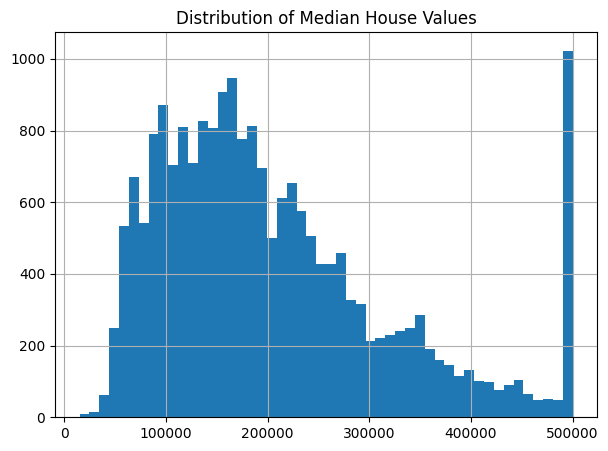

In [23]:
df.median_house_value.hist(bins=50, figsize=(7,5))
plt.title("Distribution of Median House Values")
plt.show()

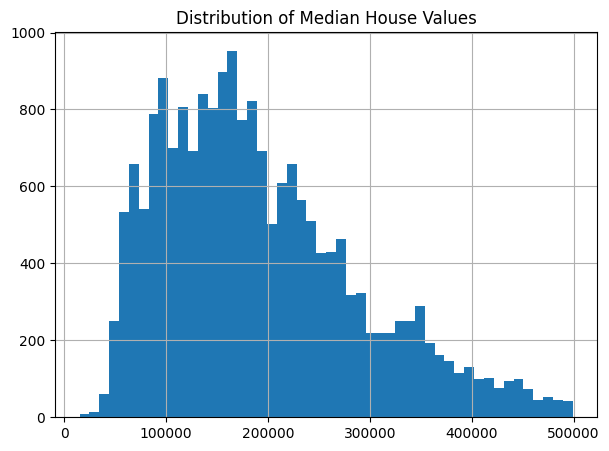

In [24]:
df.loc[df["median_house_value"] < 500_000, "median_house_value"].hist(bins=50, figsize=(7,5))
plt.title("Distribution of Median House Values")
plt.show()

To assess the impact of capped values in `median_house_value` on the quality of our Random Forest Regressor model, we can take a two-pronged approach:

1. **Train with Capped Values**: First, we'll train the model using the dataset as it is, including the capped values at $500,000. This will serve as our baseline model.

2. **Train without Capped Values**: Next, we'll remove the districts with `median_house_value` capped at $500,000 and train the model on this modified dataset. This will help us understand if removing the cap improves the model's forecasting ability.

For both models, we'll evaluate their performance using appropriate metrics like Mean Absolute Error (MAE), Root Mean Squared Error (RMSE), and R-squared (R²) to understand the impact of capped values.

Let's start with the baseline model, training with the full dataset including the capped values. We'll split the data into training and testing sets, train the Random Forest Regressor, and evaluate its performance.

In [25]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Preparing the dataset for model training
# Dropping the 'ocean_proximity' categorical feature for simplicity in this baseline model
X = df.drop(['median_house_value', 'ocean_proximity'], axis=1) # features (independent variables) that model will use to make predictions
y = df['median_house_value'] # target/dependent variable that we want to predict

# Splitting the dataset into training and testing sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) # (1) See below notes

# Training the Random Forest Regressor with capped values
rf_regressor_capped = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_capped.fit(X_train, y_train)

# Predicting on the test set
y_pred_capped = rf_regressor_capped.predict(X_test)

# Evaluating the model with capped values
mae_capped = mean_absolute_error(y_test, y_pred_capped)
rmse_capped = np.sqrt(mean_squared_error(y_test, y_pred_capped))
r2_capped = r2_score(y_test, y_pred_capped)

(mae_capped, rmse_capped, r2_capped)


(31953.78090041595, 49075.700732370366, 0.8238835420128243)

[Note (1) Splitting the dataset into training and testing sets](./support_files/train_test_split.ipynb)

The performance metrics for the Random Forest Regressor trained on the dataset with capped values at $500,000 are as follows:

- **Mean Absolute Error (MAE)**: \$31,1953.78
- **Root Mean Squared Error (RMSE)**: \$49075.70
- **R-squared (R²)**: 0.82

These metrics provide a baseline understanding of the model's performance with capped values. The R² value of 0.82 indicates that the model explains 82% of the variance in the house values, which is quite good. However, the MAE and RMSE values highlight the average and squared deviations of the predictions, respectively, and their magnitudes should be considered relative to the range of `median_house_value`.

Next, we'll train a second model after removing the districts with `median_house_value` capped at $500,000 to assess the impact of this change on the model's performance. Let's proceed with this approach.

In [26]:
# Removing districts with capped median_house_value at $500,000
df_uncapped = df[df['median_house_value'] < 500000]

# Preparing the dataset without capped values
X_uncapped = df_uncapped.drop(['median_house_value', 'ocean_proximity'], axis=1)
y_uncapped = df_uncapped['median_house_value']

# Splitting the dataset into training and testing sets
X_train_uncapped, X_test_uncapped, y_train_uncapped, y_test_uncapped = train_test_split(X_uncapped, y_uncapped, test_size=0.2, random_state=42)

# Training the Random Forest Regressor without capped values
rf_regressor_uncapped = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_uncapped.fit(X_train_uncapped, y_train_uncapped)

# Predicting on the test set
y_pred_uncapped = rf_regressor_uncapped.predict(X_test_uncapped)

# Evaluating the model without capped values
mae_uncapped = mean_absolute_error(y_test_uncapped, y_pred_uncapped)
rmse_uncapped = np.sqrt(mean_squared_error(y_test_uncapped, y_pred_uncapped))
r2_uncapped = r2_score(y_test_uncapped, y_pred_uncapped)

(mae_uncapped, rmse_uncapped, r2_uncapped)


(30030.451550128535, 44864.77399414196, 0.7937444000965301)

The performance metrics for the Random Forest Regressor trained on the dataset without the capped values at $500,000 are:

- **Mean Absolute Error (MAE)**: \$30,030.45
- **Root Mean Squared Error (RMSE)**: \$44,864.77
- **R-squared (R²)**: 0.79

Comparing these results to the model trained with capped values, we observe:

- A decrease in both MAE and RMSE, indicating better average accuracy and lower variability in the predictions.
- A slight decrease in the R² value, from 0.82 to 0.79, suggesting a marginal reduction in the model's ability to explain the variance in house values.

Removing the capped values seems to improve the model's accuracy in terms of MAE and RMSE, likely because it removes the ceiling effect that might have constrained the model's predictions. However, this comes with a slight reduction in the R² value, which could be due to the reduced range of target values, making it a bit more challenging for the model to capture the full variance in house values.

Given these insights, the decision to remove or retain the capped values may depend on the specific requirements of our project and whether accuracy or explanatory power is more critical. If the focus is on improving prediction accuracy, especially for houses valued below $500,000, removing capped values might be beneficial.

For this project, we decided to retain the capped values in our dataset. In this case our model may have slightly higher explanatory power (as indicated by a marginally higher R² value in the case with capped values). This is because the model will have a broader range of house values to learn from, including those at the high end of the market, even if those values are capped. This can be particularly useful if we are interested in understanding the factors influencing house values across the entire range of the market, including the higher end, even if the precision of predictions in that upper range might be slightly compromised due to the capping.

However, it's essential to weigh this against the potential downside: the capped values at $500,000 could introduce a bias in predictions around that threshold, as the model might learn that house values do not exceed this cap, which isn't true in reality. This could affect the accuracy of predictions, particularly for houses that would naturally have values above the cap if it weren't in place.

Ultimately, the decision should align with the goals of our project:

- **For predictive accuracy**, especially in predicting values below the cap, removing capped values might yield better results.
- **For explanatory analysis** across the full range of the dataset, including understanding high-value districts, keeping the capped values might provide more insights, albeit with the caveat of potential bias around the cap.

It's a trade-off between the granularity and accuracy of predictions in the lower to mid-range of house values and the model's ability to generalize and explain variance across the entire dataset, including the capped upper range. Our project's specific objectives and requirements should guide this decision.

## (4) Feature Engineering - Part 1

Next, we'll move on to feature engineering. 

Feature engineering is the process of creating new features from existing ones to improve the performance of machine learning models. The goal is to transform raw data into features that better represent the underlying problem to the predictive models, thereby improving their accuracy on unseen data. 

In the context of housing data,  "number of rooms per household", "bedrooms per room" and "population per household" are examples of such engineered features that can provide more nuanced insights into the data. 

We have several features that measure the size of the district, for instance, the total population, the total number of households, and also the total number of bedrooms and rooms. However, for our purposes, it could be a good idea to combine those raw data and create new features.

Sometimes it can be beneficial to transform a numerical feature into a categorical feature with, for example, five categories. In our example, there could be the low-income bin, the below-average income bin, the above-average, the high, and the very high-income bin. These are five incumbents and this is called discretization or binning. Also discretizing and binning are considered forms of feature engineering.

Here's what they mean:

### (4.1) Number of Rooms per Household - indicator for household size. The larger the size, the higher the house value

The feature "number of rooms per household" is example of engineered feature derived from the existing data in a housing dataset. This feature is calculated by dividing the total number of rooms by the number of households in each district. It represents the average number of rooms available per household, providing an insight into the spaciousness or size of living quarters in a district. A higher value for "rooms per household" might suggest that the households, on average, have more space, potentially making the area more attractive to buyers looking for larger living spaces. This could, in turn, influence the median house value in the area.

**Calculation**: `rooms_per_household = total_rooms / households`

In a predictive model for house values, this feature could be significant. Houses in districts with a higher average number of rooms per household might be valued more because they offer more space, which is often a desirable attribute. Moreover, this feature can help differentiate between areas with many small apartments (lower rooms per household) and those with fewer, but larger, houses (higher rooms per household), which can be an important factor in housing prices.

In [27]:
df["rooms_per_household"] = df.total_rooms.div(df.households)

let's get the ten largest values:

In [28]:
df.rooms_per_household.value_counts()

rooms_per_household
5.000000    27
4.500000    22
4.000000    21
6.000000    19
5.333333    13
            ..
6.451923     1
4.656757     1
3.285714     1
4.854839     1
5.254717     1
Name: count, Length: 19202, dtype: int64

Five rooms is the most common size per household.

In [29]:
df.rooms_per_household.describe()

count    20433.000000
mean         5.431344
std          2.482946
min          0.846154
25%          4.441441
50%          5.230769
75%          6.052381
max        141.909091
Name: rooms_per_household, dtype: float64

The `rooms_per_household` statistics provide insight into the distribution of the average number of rooms per household across all districts in your dataset. Here's an interpretation of these numbers:

- **count**: There are 20,433 non-null entries for the `rooms_per_household` feature, indicating the number of households included in this analysis.

- **mean**: The average number of rooms per household across all districts is approximately 5.43. This suggests that, on average, each household in the dataset has about 5 to 6 rooms, which could include bedrooms, living rooms, kitchens, etc.

- **std (Standard Deviation)**: The standard deviation is about 2.48, which shows the average deviation of the `rooms_per_household` values from the mean. A standard deviation of this size indicates a moderate level of variability in the number of rooms per household across different districts.

- **min**: The minimum value of `rooms_per_household` is approximately 0.85, indicating that the household with the fewest rooms in any district has less than one room per household on average. This might be due to shared accommodations or a statistical anomaly where the number of households is overestimated or the number of rooms is underestimated.

- **25% (First Quartile)**: 25% of the districts have 4.44 rooms or fewer per household. This lower quartile shows that a quarter of the districts have relatively fewer rooms per household, indicating more compact living spaces.

- **50% (Median)**: The median value of `rooms_per_household` is about 5.23, suggesting that half of the districts have more than this number of rooms per household and half have fewer. This median provides a more robust central tendency measure than the mean, as it's less affected by extreme values.

- **75% (Third Quartile)**: 75% of the districts have 6.05 rooms or fewer per household. This indicates that most districts have a moderate number of rooms per household, with a quarter of the districts having more spacious accommodations.

- **max**: The maximum value of `rooms_per_household` is extremely high at 141.91, suggesting that there is at least one district where the average household has about 142 rooms. This is highly unusual and likely an outlier, potentially due to data errors such as a very small number of households with a large number of rooms or incorrect data entries.

In summary, the `rooms_per_household` feature suggests that the typical household in the dataset has about 5 to 6 rooms, with a moderate variation across districts. The presence of a very high maximum value indicates an outlier, which could distort the mean and warrants further investigation to ensure data quality and accuracy.

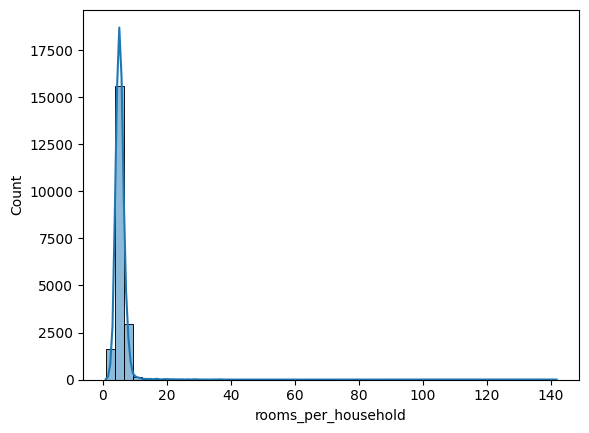

In [30]:
sns.histplot(df.rooms_per_household, kde=True, bins=50)
plt.show()

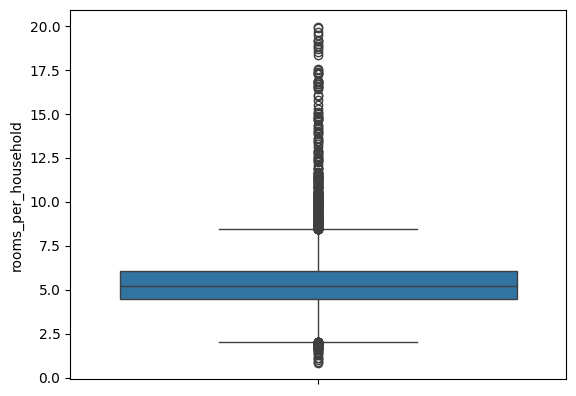

In [31]:
sns.boxplot(df.loc[df.rooms_per_household<20, "rooms_per_household"])
plt.show()

The distribution is right-skewed, and we can see extreme values on the right and left sides. Those extreme values we may consider removing but in this example, we just leave them.

In [32]:
df.rooms_per_household.nlargest(10)

1903     141.909091
1968     132.533333
12328     62.422222
1902      61.812500
11745     59.875000
1901      56.269231
9581      52.848214
11591     52.690476
2378      50.837838
1233      47.515152
Name: rooms_per_household, dtype: float64

There is a district where we have an average rooms per household of 141.
So either this is the Castle district or some data might be wrong.

In [33]:
df.iloc[[1903, 1968], :]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household
1903,-120.10,38.91,33.0,1561.0,282.0,30.0,11.0,1.875,500001.0,INLAND,141.909091
1968,-120.08,38.80,34.0,1988.0,511.0,36.0,15.0,4.625,162500.0,INLAND,132.533333


Let's have a look at the ten smallest values.

In [34]:
df.rooms_per_household.nsmallest(10)

5854     0.846154
8132     0.888889
3102     1.000000
14677    1.130435
17653    1.130435
4509     1.260870
4507     1.378486
4544     1.411290
4557     1.465753
12365    1.550409
Name: rooms_per_household, dtype: float64

In [35]:
df.iloc[[5854, 8132], :]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household
5854,-118.44,34.28,46.0,11.0,11.0,24.0,13.0,2.8750,162500.0,<1H OCEAN,0.846154
8132,-118.21,33.79,33.0,32.0,18.0,96.0,36.0,4.5938,112500.0,NEAR OCEAN,0.888889


So we have 0.84 and 0.88. This doesn't make much sense because it means we have less than one room per household. 

### (4.2) Population per Household - indicator for average number of people living in each household. The higher the ratio the lower the house price

This feature is calculated by dividing the total population by the number of households in a district. It essentially indicates the average number of people living in each household, providing insights into the occupancy rate or how crowded the households might be. A higher "population per household" ratio could suggest more crowded living conditions, which might correlate with lower house values in some cases, or indicate a demand for more housing in the area. Understanding the average household size can provide context for the demand for housing, potentially affecting prices.

**Calculation**: `population_per_household = population / households`

These engineered features can be more informative for predictive modeling than just the raw totals because they offer a relative measure that can be more directly related to house values or desirability.

In [36]:
df["pop_per_household"] = df.population.div(df.households)

In [37]:
df.pop_per_household.describe()

count    20433.000000
mean         3.071533
std         10.438269
min          0.692308
25%          2.429032
50%          2.817582
75%          3.281513
max       1243.333333
Name: pop_per_household, dtype: float64

The `population_per_household` statistics give us insights into the average household size across all districts in terms of the number of people living in each household. Here's how to interpret these figures:

- **count**: Indicates there are 20,433 records in your dataset for the `population_per_household` feature, matching the counts for other features and suggesting complete data for this calculation.

- **mean**: The average number of people per household across all districts is about 3.07. This suggests that, on average, there are roughly 3 people living in each household across the dataset's districts.

- **std (Standard Deviation)**: A standard deviation of 10.44 is quite high relative to the mean, indicating significant variability in household sizes across different districts. This high standard deviation suggests the presence of some extreme values or outliers in the data.

- **min**: The minimum value of `population_per_household` is about 0.69, indicating that the smallest average household size in any district is less than one person. This could be due to statistical anomalies, such as a high number of unoccupied households or errors in data collection or recording.

- **25% (First Quartile)**: 25% of districts have an average household size of 2.43 or fewer people. This lower quartile suggests that a quarter of the districts have smaller household sizes, which could reflect a variety of socio-economic and cultural factors.

- **50% (Median)**: The median average household size is about 2.82, meaning that half of the districts have a larger average household size and half have a smaller one. The median provides a more resistant measure of central tendency than the mean, especially in the presence of outliers.

- **75% (Third Quartile)**: 75% of districts have an average household size of 3.28 or fewer. This indicates that most districts have relatively small to moderate household sizes, with the remaining quarter having larger average household sizes.

- **max**: The maximum average household size is extremely high at 1,243.33, which is highly unusual and almost certainly an outlier. Such a value could significantly skew the mean and indicates that there might be districts with abnormally high population counts relative to the number of households, or there might be data recording errors.

In summary, the `population_per_household` feature suggests that the typical household size across the districts in the dataset is about 2 to 3 people, with a wide range of variability indicated by the high standard deviation. The presence of an extremely high maximum value suggests that there are outliers or possibly erroneous data entries that could distort the overall picture and might need further investigation or cleaning.

In [38]:
df.iloc[[df.pop_per_household.idxmax()], :]

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,pop_per_household
18825,-121.98,38.32,45.0,19.0,5.0,7460.0,6.0,10.2264,137500.0,INLAND,3.166667,1243.333333


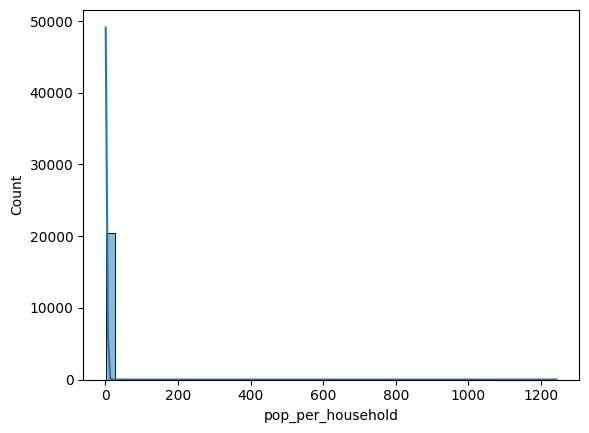

In [39]:
sns.histplot(df.pop_per_household, kde=True, bins=50)
plt.show()

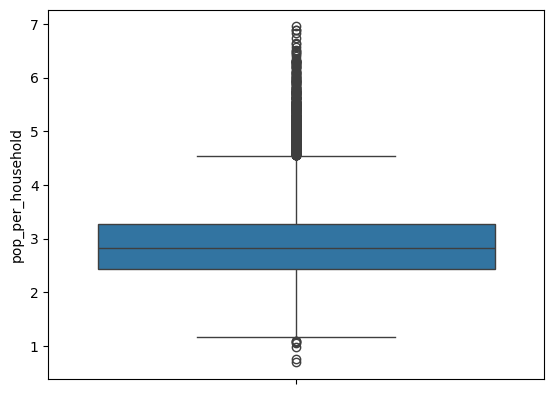

In [40]:
sns.boxplot(df.loc[df.pop_per_household<7, "pop_per_household"])
plt.show()

The distribution is right-skewed, and we can see extreme values on the right and left sides. Those extreme values we may consider removing but in this example, we just leave them.

### (4.3) Bedrooms per Room - indicator of how densely the living spaces are allocated towards sleeping areas. The higher the ratio the lower the house value

This feature is calculated by dividing the total number of bedrooms by the total number of rooms in each district. It represents the proportion of bedrooms out of all rooms, giving an idea of how densely the living spaces are allocated towards sleeping areas. A higher "bedrooms per room" ratio might indicate that a larger portion of the living space is dedicated to bedrooms, which could influence the house value or desirability for certain demographics. For example, two districts might have the same total number of rooms, but if one has significantly more bedrooms overall, it might be considered less spacious and possibly less desirable, which could reflect in lower house values. On the contrary, two districts might have the same total number of bedrooms, but if one has significantly more rooms overall, it might be considered more spacious and possibly more desirable, which could be reflected in higher house values.

**Calculation**: `bedrooms_per_room = total_bedrooms / total_rooms`

In [41]:
df["bedrooms_per_room"] = df.total_bedrooms.div(df.total_rooms)

In [42]:
df.bedrooms_per_room.describe()

count    20433.000000
mean         0.213039
std          0.057983
min          0.100000
25%          0.175427
50%          0.203162
75%          0.239821
max          1.000000
Name: bedrooms_per_room, dtype: float64

The statistics for the `bedrooms_per_room` ratio, derived from your dataset, provide insights into the distribution and variation of this feature across all districts. Here's how to interpret these numbers:

- **mean**: The average `bedrooms_per_room` ratio across all districts is approximately 0.213. This means that, on average, about 21.3% of the rooms in a district are bedrooms.

- **std (Standard Deviation)**: The standard deviation is about 0.058, indicating the average amount by which the `bedrooms_per_room` ratio varies from the mean. A standard deviation of 0.058 suggests that there is some variability in how rooms are allocated as bedrooms across different districts, but it's not extremely high.

- **min**: The minimum value of the `bedrooms_per_room` ratio is 0.1, indicating that in the district with the lowest ratio, only 10% of the rooms are bedrooms. This could suggest a district with more emphasis on living spaces, communal areas, or non-bedroom rooms.

- **25% (First Quartile)**: 25% of the districts have a `bedrooms_per_room` ratio of 0.175 or lower. This first quartile indicates that in a quarter of the districts, no more than 17.5% of rooms are bedrooms, pointing towards a lower bedroom to room ratio in these areas.

- **50% (Median)**: The median `bedrooms_per_room` ratio is approximately 0.203. Half of the districts have a ratio below this value, and half have a ratio above, making it a good indicator of the typical bedroom proportion relative to total rooms, unaffected by outliers.

- **75% (Third Quartile)**: 75% of the districts have a `bedrooms_per_room` ratio of 0.24 or lower. This means that in most districts, less than 24% of rooms are bedrooms, with the remaining space likely allocated to other types of rooms.

- **max**: The maximum `bedrooms_per_room` ratio is 1.0, indicating that there is at least one district where every room is a bedroom. This is an extreme case and could be an outlier or a special case scenario, such as a dormitory district, housing specifically designed for sleeping quarters, or a data entry error.

In summary, these statistics suggest that, on average, about one-fifth of the rooms in the districts are bedrooms, with some variation across different districts. The relatively low standard deviation indicates that while there is some diversity in how room space is allocated across districts, it's not extremely wide. The presence of a maximum value at 1.0, where all rooms are bedrooms, is unusual and could warrant further investigation to understand the nature of that specific district.

In [43]:
df.iloc[[df.bedrooms_per_room.idxmin()], :] # The lower the ratio the higher the house value

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room
1556,-121.96,37.74,2.0,200.0,20.0,25.0,9.0,15.0001,350000.0,<1H OCEAN,22.222222,2.777778,0.1


In [44]:
df.iloc[[df.bedrooms_per_room.idxmax()], :] # The higher the ratio the lower the house value

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room
3102,-117.79,35.21,4.0,2.0,2.0,6.0,2.0,2.375,137500.0,INLAND,1.0,3.0,1.0


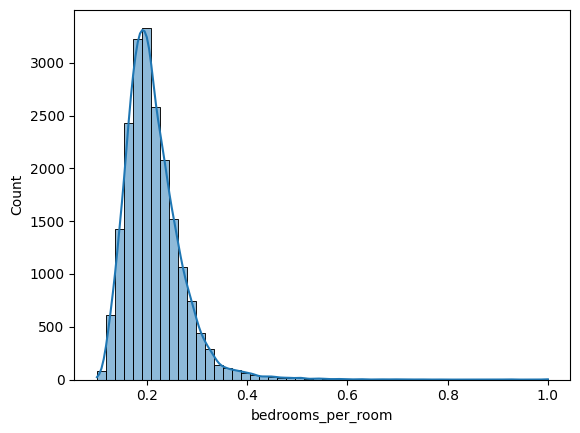

In [45]:
sns.histplot(df.bedrooms_per_room, kde=True, bins=50)
plt.show()

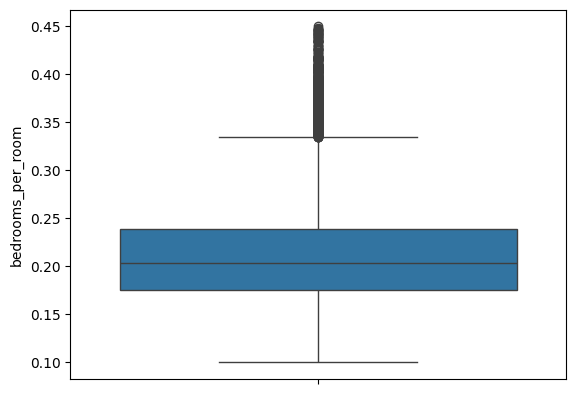

In [46]:
sns.boxplot(df.loc[df.bedrooms_per_room<0.45, "bedrooms_per_room"])
plt.show()

The distribution is right-skewed and we can see extreme values on the right-hand side. Those extreme values we may consider removing but in this example, we just leave them.

### (4.4) Recommendations on how to deal with outliers in the newly engineered features

Given the descriptive statistics for your engineered features (`bedrooms_per_room`, `rooms_per_household`, and `population_per_household`) and the presence of outliers, particularly the extreme maximum values, further data cleaning could indeed be beneficial before proceeding with machine learning modeling. Here's why:

#### 1. **Outliers Impact**
- **Extreme Values**: The extremely high maximum values in `rooms_per_household` and `population_per_household` suggest the presence of outliers, which could be due to data errors, special cases, or genuinely large values. Such outliers can skew the data distribution and potentially lead to biased model training, especially if these outliers are not representative of the general population or the scenarios you aim to predict.
- **Data Quality**: Outliers might indicate issues with data quality, such as errors in data collection, entry, or processing. Addressing these can improve the overall reliability of your dataset.

#### 2. **Model Performance**
- **Generalization**: While Random Forest is robust to outliers to some extent, cleaning the data to remove non-representative outliers can help the model generalize better to unseen data, improving its predictive performance.
- **Feature Importance**: Outliers can also affect the computation of feature importance in Random Forest models, potentially overstating the importance of features associated with outliers.

#### 3. **Data Understanding**
- **Anomaly Detection**: Investigating outliers can provide insights into the data and the domain. Some outliers might be genuine and could reveal interesting domain-specific phenomena that are worth understanding separately.
- **Consistency**: Ensuring that the data is consistent and accurately represents the problem space is crucial for the trustworthiness of the model's predictions.

#### Recommendations for Further Data Cleaning:
- **Outlier Analysis**: Conduct a thorough analysis of the outliers to determine their nature. Are they genuine values, data entry errors, or anomalies?
- **Domain Consultation**: If possible, consult domain experts to understand if such extreme values are plausible within the context of your data.
- **Thresholding**: For genuine but non-representative outliers (e.g., extremely large households that are not common), consider applying thresholding to cap extreme values at a more representative level.
- **Removal**: If outliers are determined to be errors, consider removing these records from the dataset.
- **Data Transformation**: In some cases, applying a transformation (e.g., log transformation) to skewed features can mitigate the influence of outliers.

After cleaning or adjusting the data, it's a good practice to reassess the descriptive statistics and distributions of your features to ensure that the data cleaning steps have addressed the concerns without introducing new issues. Additionally, keep track of any decisions and transformations made during this process, as they may need to be applied to new data before making predictions in a production environment. 

For this project I will keep the outliers are they are but for the future project I will consider to deal with them as recommended above.

### (4.5) Discretization and binning. Transform Median Income feature to Income categorical feature

Discretizing and binning are considered forms of feature engineering. Sometimes it can be beneficial to transform a numerical feature into a categorical feature with,
for example, five categories. In our example, there could be the low income bin, the below average income bin, the above average, the high and the very high income bin.
These are five incumbents and this is called discretization or binning.

We could define quantiles or percentiles and so we could say that the lowest 25% in terms of income belong to the low income bin and so on:

In [47]:
df.head(2)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,2.555556,0.146591
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,2.109842,0.155797


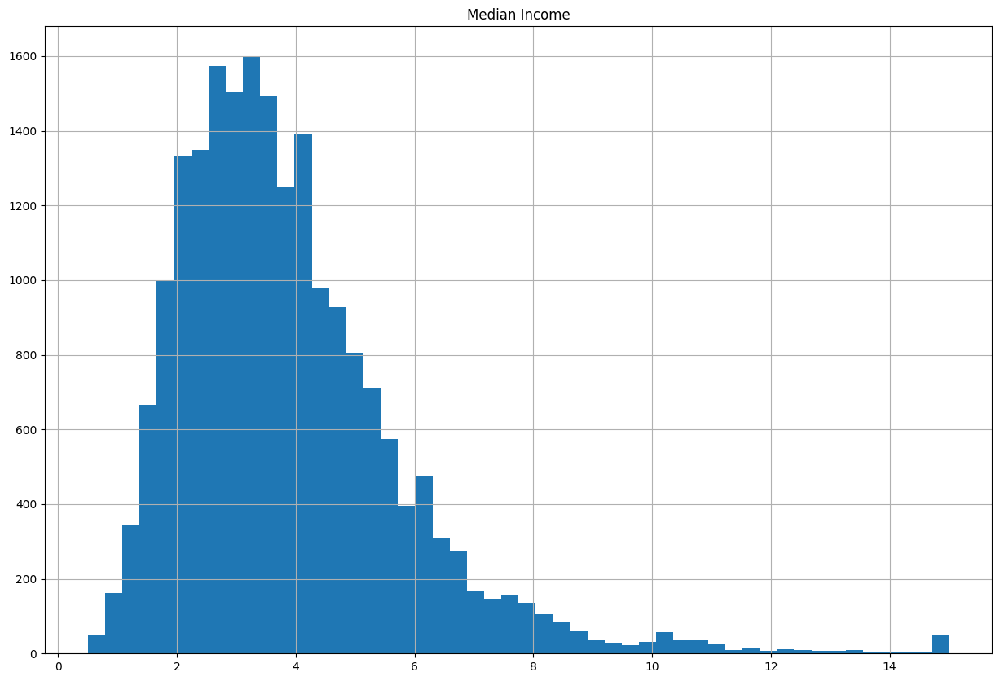

In [48]:
df.median_income.hist(bins=50, figsize=(15,10))
plt.title("Median Income")
plt.show()

First of all, we pass the column median income and then we define the percentiles.

We could say that the 25% lowest income districts are organized in the first bin. So from zero till the 25th percentile. Then we have the next bin from the 25th percentile to the 50th percentile. Then we have the third bin from the 50th to the 75th percentile. Next we have the fourth bin from the 75th percentile to the 95th percentile. Finally we have the 5% of all districts with the highest income.

In [49]:
pd.qcut(df.median_income, q = [0, 0.25, 0.5, 0.75, 0.95, 1])

0           (7.3, 15.0]
1           (7.3, 15.0]
2          (4.744, 7.3]
3          (4.744, 7.3]
4        (3.536, 4.744]
              ...      
20428    (0.499, 2.564]
20429    (0.499, 2.564]
20430    (0.499, 2.564]
20431    (0.499, 2.564]
20432    (0.499, 2.564]
Name: median_income, Length: 20433, dtype: category
Categories (5, interval[float64, right]): [(0.499, 2.564] < (2.564, 3.536] < (3.536, 4.744] < (4.744, 7.3] < (7.3, 15.0]]

So we have five income categories.
- The first one from 0.5 to 2.5.
- Then the second from 2.5 till 3.5 and so on.
- And the highest 5% are between 7.3 and 15.

In [50]:
df["income_cat"] = pd.qcut(df.median_income, q = [0, 0.25, 0.5, 0.75, 0.95, 1],
                           labels = ["Low", "Below_Average", "Above_Average", "High", "Very High"])

In [51]:
df.income_cat

0            Very High
1            Very High
2                 High
3                 High
4        Above_Average
             ...      
20428              Low
20429              Low
20430              Low
20431              Low
20432              Low
Name: income_cat, Length: 20433, dtype: category
Categories (5, object): ['Low' < 'Below_Average' < 'Above_Average' < 'High' < 'Very High']

Now we can also call the value counts method, but instead of getting the absolute counts, we can also get the relative counts by passing true to normalize:

In [52]:
df.income_cat.value_counts(normalize = True)

income_cat
Low              0.250037
Above_Average    0.250037
Below_Average    0.249988
High             0.199922
Very High        0.050017
Name: proportion, dtype: float64

Now we should get 25% for the low category, then also 25% for below average and the 25% for above average and 20% for high and finally, 5% for for very high. And indeed, we have 25%, 25%, and again, 25, 20 and 5%. So due to rounding issues, we do not have exactly 25%. But these are actually minor differences here.

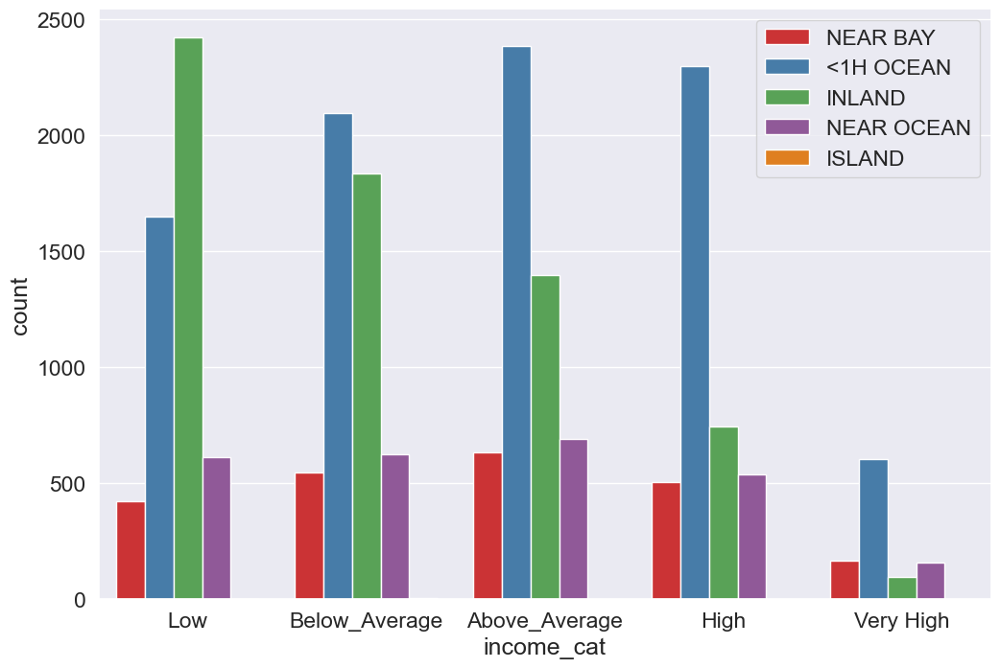

In [53]:
plt.figure(figsize=(12,8))
sns.set(font_scale=1.5, palette= "Set1")
sns.countplot(data = df, x = "income_cat", hue = "ocean_proximity")
plt.legend(loc = 1)
plt.show()

Here we can see that districts with a low median income are mainly located in the inland. Once we increase the income category, the count of inland decreases and the count of nearby or less than one hour to the ocean increases.

So let's have a look at the very high income category. The districts with a very high median income are mainly located  less than one hour drive from the ocean.

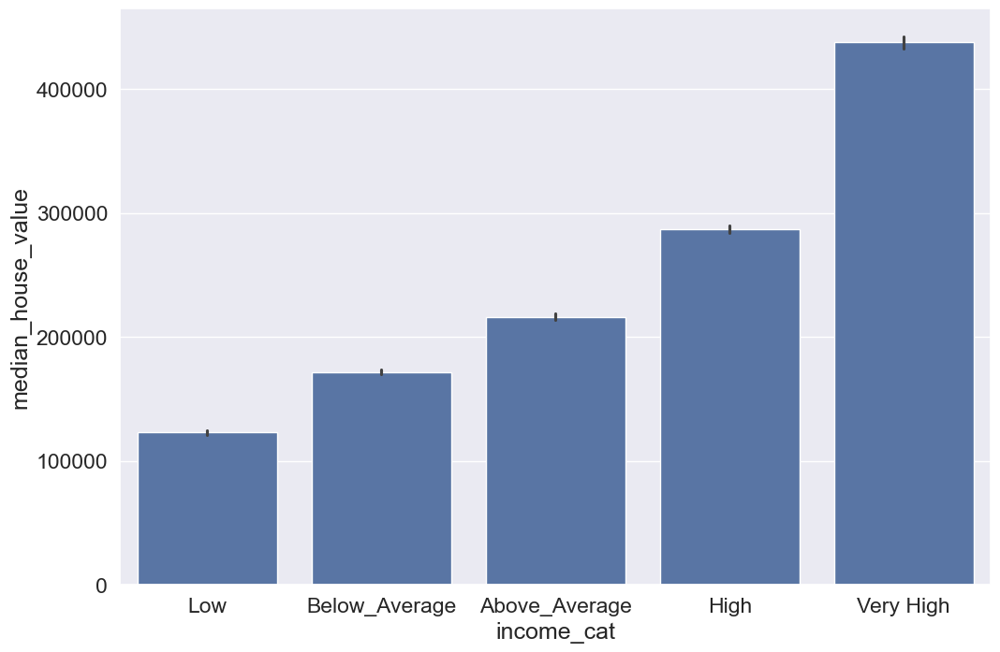

In [54]:
plt.figure(figsize=(12,8))
sns.set(font_scale=1.5)
sns.barplot(data = df, x = "income_cat", y = "median_house_value", dodge = True)
plt.show()

This graph simply says that the higher the median income in the district, the higher the median house values. So if we have a district with a low median income, then the average house value is around about 120,000. And for the very high income category, we have an average median house value of around about 450,000.

## (5) Exploratory Data Analysis. Which Factors influence House Prices?

### (5.1) Understand  distribution of 'ocean_proximity' categorical feature and how it relates to the 'median_house_value'

Next, we can explore the 'ocean_proximity' categorical feature to understand its distribution and how it relates to the median house value. 

To explore the 'ocean_proximity' categorical feature, we'll perform two analyses:

1. **Distribution Analysis**: We'll examine the frequency of each category within 'ocean_proximity' to understand how districts are distributed across different proximity categories to the ocean.

2. **Relationship with Median House Value**: We'll investigate how the median house value varies across different 'ocean_proximity' categories to see if there's a noticeable impact of ocean proximity on house values.

Let's start with the distribution analysis by creating a bar plot to visualize the frequency of districts in each 'ocean_proximity' category.

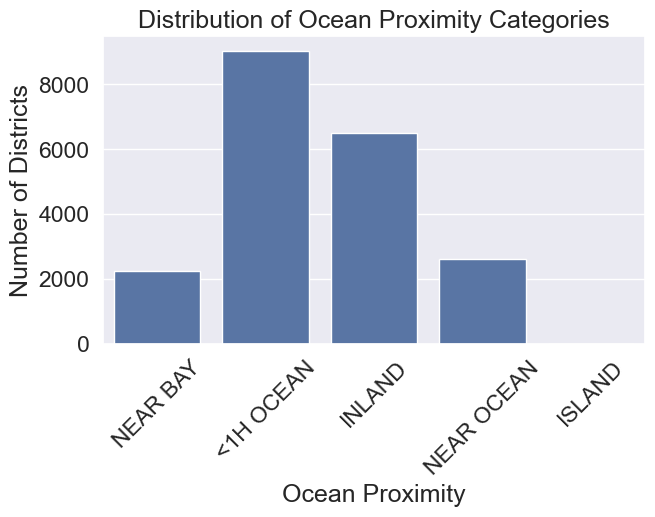

In [55]:
# Distribution analysis of 'ocean_proximity'
plt.figure(figsize=(7, 4))
sns.countplot(data=df, x='ocean_proximity')
plt.title('Distribution of Ocean Proximity Categories')
plt.xlabel('Ocean Proximity')
plt.ylabel('Number of Districts')
plt.xticks(rotation=45)
plt.show()

The bar plot above shows the distribution of districts across different 'ocean_proximity' categories. It appears that the majority of districts fall into the "<1H OCEAN" category, indicating they are within an hour's drive to the ocean. The other categories, including "INLAND," "NEAR OCEAN," "NEAR BAY," and a very small number in the "ISLAND" category, have fewer districts in comparison.

Next, we'll explore how the median house value varies across these 'ocean_proximity' categories. This will involve comparing the median house values for districts in each category to see if proximity to the ocean has a noticeable impact on house prices. We'll use a box plot for this analysis to visualize the median values and the distribution of house values within each category.


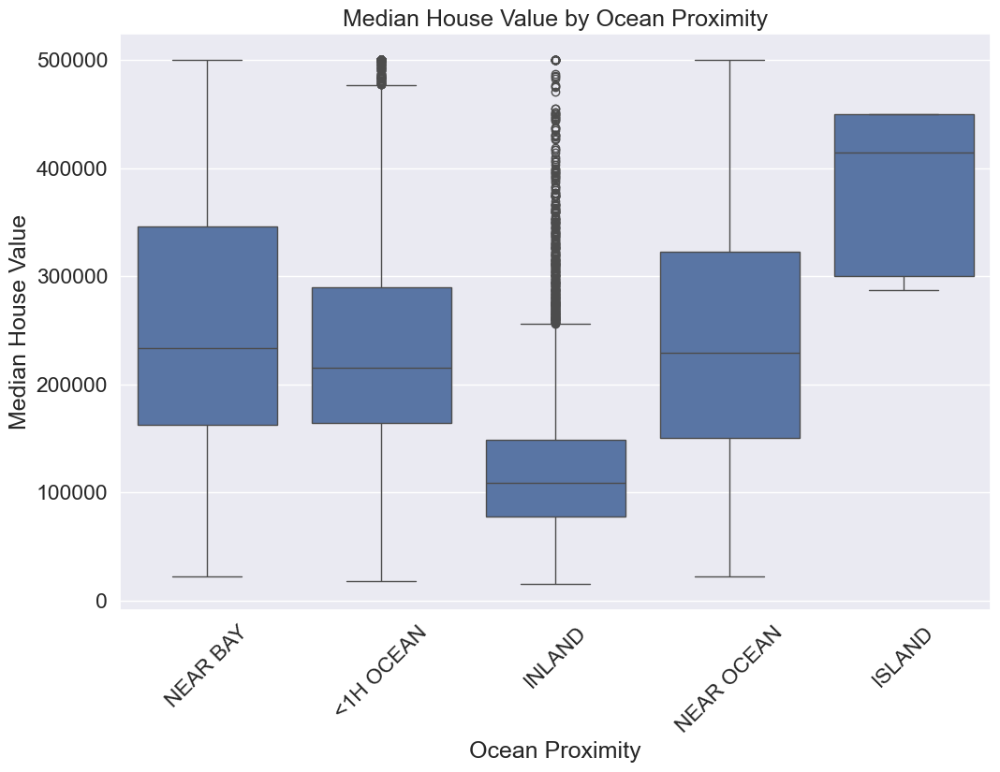

In [56]:
# Relationship between 'ocean_proximity' and 'median_house_value'
plt.figure(figsize=(12, 8))
sns.boxplot(data=df, x='ocean_proximity', y='median_house_value')
plt.title('Median House Value by Ocean Proximity')
plt.xlabel('Ocean Proximity')
plt.ylabel('Median House Value')
plt.xticks(rotation=45)
plt.show()

The box plot illustrates how median house values vary across different 'ocean_proximity' categories:

- **<1H OCEAN**: Districts within an hour's drive to the ocean have a wide range of house values, with a median value that suggests moderate prices compared to other categories. There's notable variability in house values, indicating diversity in the types of districts within this category.

- **INLAND**: Districts classified as inland tend to have lower median house values, with a narrower interquartile range, indicating less variability in house prices compared to coastal areas.

- **NEAR OCEAN**: Districts near the ocean generally have higher median house values, with a slightly wider distribution of values, suggesting a premium for proximity to the ocean.

- **NEAR BAY**: Similar to the 'NEAR OCEAN' category, districts near the bay also exhibit higher median house values, with a broad range of values, indicating variability in the desirability of locations within this category.

- **ISLAND**: There's a very small number of districts in the 'ISLAND' category, which makes it difficult to draw definitive conclusions, but the median house value appears to be higher, possibly reflecting a premium for island locations.

This analysis suggests that ocean proximity is an influential factor in determining house values, with coastal locations generally commanding higher prices. This insight can be crucial for feature engineering and model training, as 'ocean_proximity' might be a significant predictor for the median house value.

### (5.2) Correlation Analysis between Label(House values) and Features

The correlation values between various features and median_house_value in your dataset provide insights into how each feature is linearly related to the house values. We are only interested in correlations between label and features, so between house values and the features.

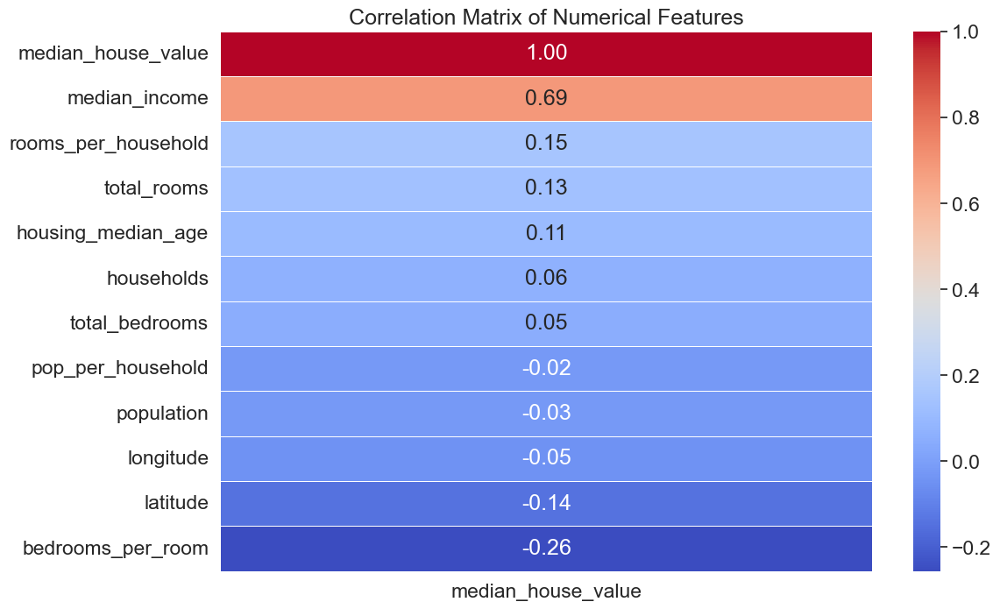

In [57]:
# Calculate the correlation matrix
correlation_matrix = df.corr(numeric_only=True).median_house_value.sort_values(ascending=False).to_frame()

# Plot the heatmap for the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Numerical Features')
plt.show()

The correlation values between various features and `median_house_value` in your dataset provide insights into how each feature is linearly related to the house values. Here's how to interpret these correlation coefficients:

*Positive Correlation:*  
A positive correlation value indicates that as the feature increases, the `median_house_value` tends to increase as well.

- **median_income (0.69)**: Shows a strong positive correlation, indicating that higher median income levels in a district are associated with higher median house values. This is the most significant positive correlation, suggesting median income is a key predictor of house values.
- **rooms_per_household (0.15)**: Indicates a modest positive correlation, suggesting that districts with more rooms per household tend to have higher house values. This could reflect larger, more spacious houses that are more valuable.
- **total_rooms (0.13)**: Shows a positive correlation, implying that districts with more total rooms tend to have higher median house values, possibly due to larger housing sizes.
- **housing_median_age (0.11)**: A slight positive correlation suggests that older housing stock might be associated with slightly higher house values, possibly due to historical or architectural value.
- **households (0.06)** and **total_bedrooms (0.05)**: These show very weak positive correlations, indicating a minor association with higher house values. This could be due to the larger number of bedrooms and households reflecting larger housing structures.

*Negative Correlation:*  
A negative correlation value indicates that as the feature increases, the `median_house_value` tends to decrease.

- **bedrooms_per_room (-0.26)**: Shows a moderate negative correlation, suggesting that a higher proportion of bedrooms relative to total rooms is associated with lower house values. This could indicate that houses with more bedrooms than usual living spaces are less valued.
- **latitude (-0.14)**: Indicates that as you move north (higher latitude), median house values tend to decrease, suggesting geographical patterns in house valuation.
- **longitude (-0.05)**, **population (-0.03)**, and **pop_per_household (-0.02)**: These features show very weak negative correlations with house values, suggesting a minor or negligible association. The negative correlation with population might reflect the fact that more densely populated areas (or areas with more people per household) do not necessarily have higher house values.

*Interpretation Considerations:*  
- **Magnitude and Direction**: The magnitude of the correlation coefficient indicates the strength of the relationship, with values closer to -1 or 1 being stronger. The sign indicates the direction (positive or negative correlation).
- **Linearity**: These correlations measure linear relationships. Non-linear relationships would not be well-represented by correlation coefficients.
- **Causality**: Correlation does not imply causation. High or low correlation between a feature and the target variable doesn't mean one causes the other to increase or decrease.

In summary, the most substantial correlation is observed with `median_income`, indicating its importance as a predictive feature for `median_house_value`. Features like `rooms_per_household` and `bedrooms_per_room` also show significant correlations, suggesting their potential utility in predicting house values, albeit to a lesser extent. The negative correlation of `bedrooms_per_room` is particularly interesting as it inversely relates to house values, highlighting the importance of the balance between bedrooms and other living spaces in determining house values.

### (5.3) Correlations between House Value and Median Income

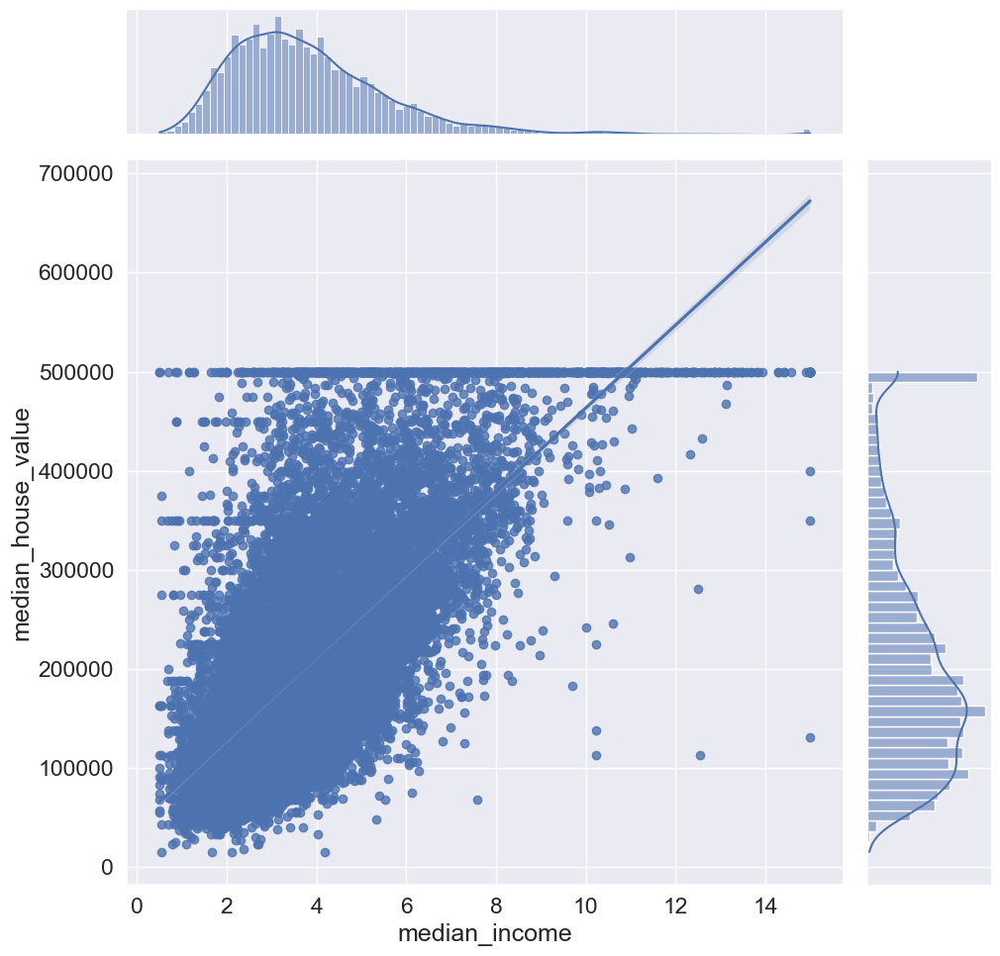

In [58]:
sns.set(font_scale=1.5)
sns.jointplot(data = df, x = "median_income", y = "median_house_value", kind = "reg", height = 10)
plt.show()

So this is a scatter plot with a linear regression line. And we can see clearly that the median house values are capped at 500,000.
We can also see that there is a strong positive linear relationship between house values and the income. So the higher the income, the higher the house prices.

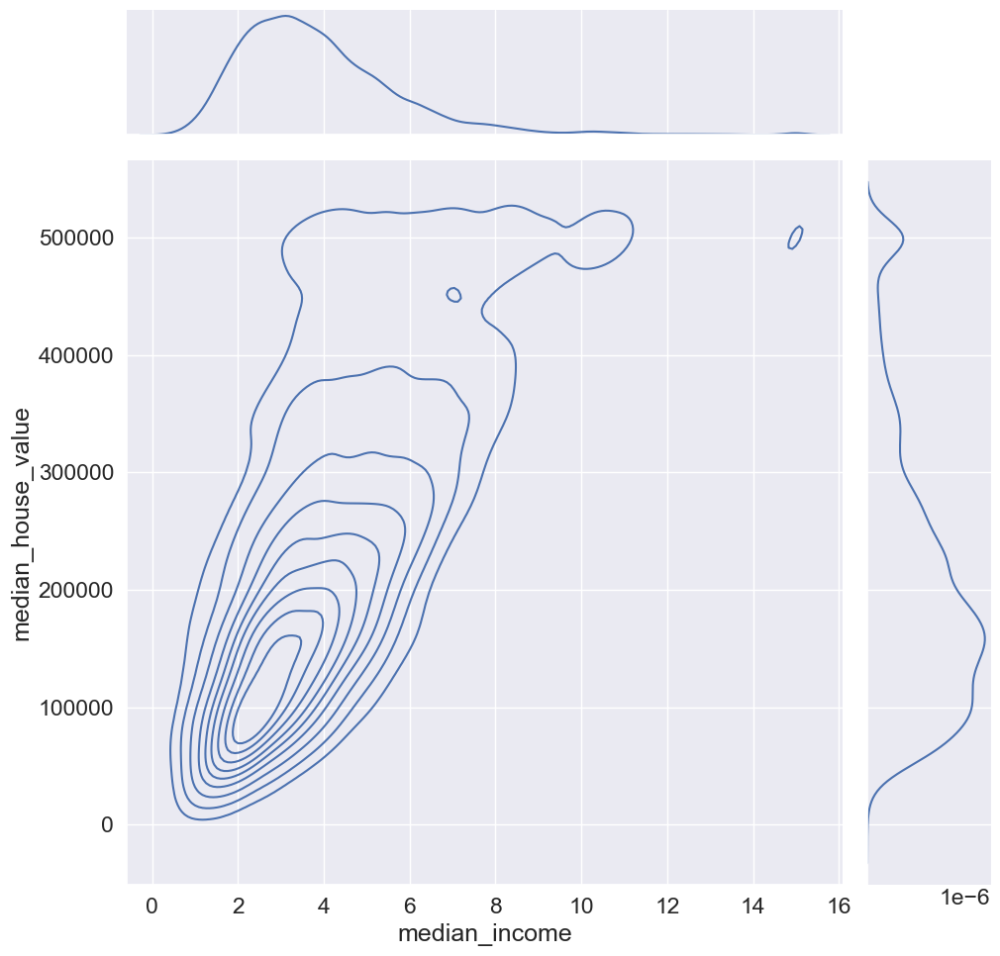

In [59]:
sns.set(font_scale=1.5)
sns.jointplot(data = df, x = "median_income", y = "median_house_value", kind = "kde", height = 10)
plt.show()

We can also create a so-called kernel density estimator KDE. We can see here the most frequent values where we can find most of the data points. So the most common combination is an income of 3 and house values round about 100,000. Here, we can see a positive linear relationship.

### (5.4) Explore Non-linear Relationship betwee Location and House Prices using map plotting

#### Plot showing the geographical distribution of median house values in California, with the size of each point representing the population of the district. Using pre-defined map

In [60]:
df.head(2)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room,income_cat
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,2.555556,0.146591,Very High
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,2.109842,0.155797,Very High


Below plot showing the geographical distribution of median house values in California, with the size of each point representing the population of the district and the color indicating the median house value. 

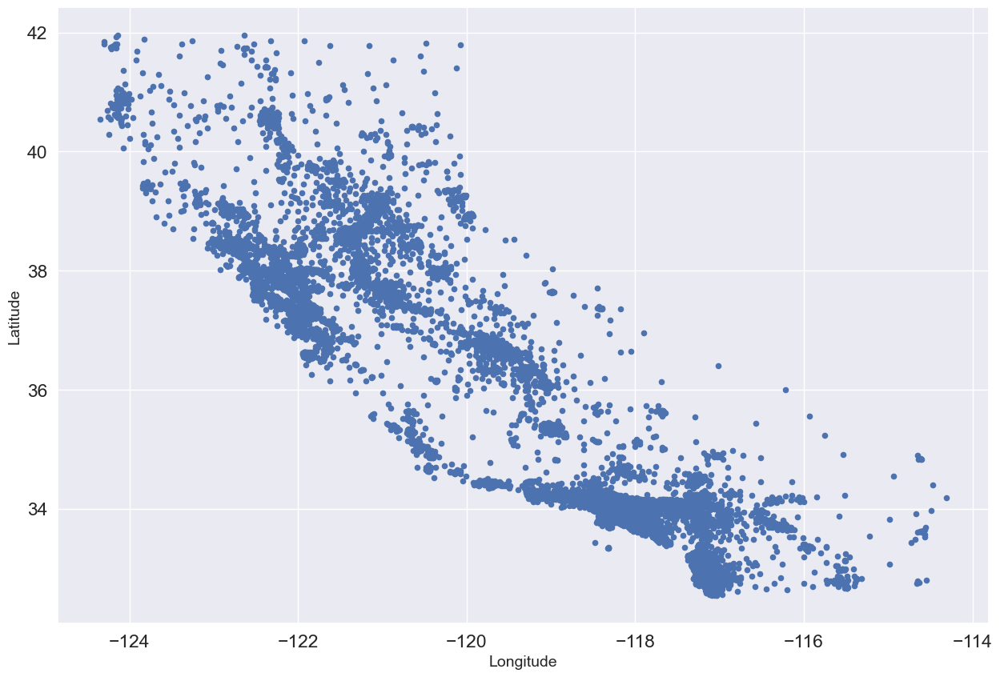

In [61]:
# (1) we can create a scatter plot with the plot method, and on the x axis we want to have the longitude
#and on the y axis, the latitude. So each and every data point here is one district:
df.plot(kind = "scatter", x = "longitude", y = "latitude", figsize = (15, 10))
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.show()

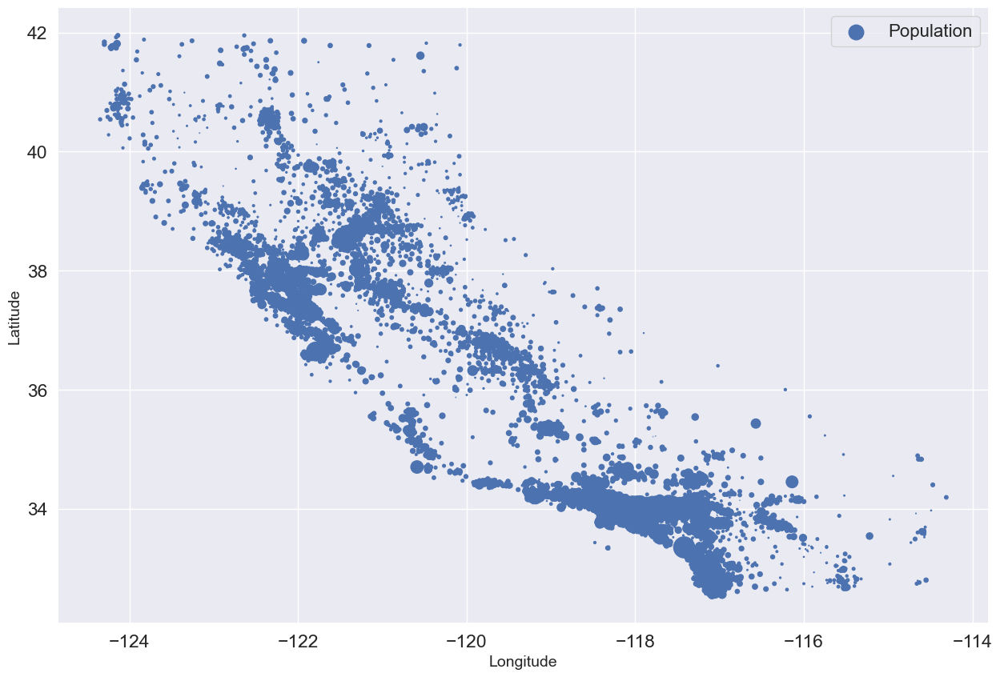

In [62]:
# (2) We can also determine the size of the districts and the size should be 
# determined by the population. We divide it by 100 to adjust the size of the dot. 
# We give the lable. The larger the data point, the higher the population.
df.plot(kind = "scatter", x = "longitude", y = "latitude", figsize = (15, 10),
       s = df["population"]/100, label = "Population");
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)
plt.show()

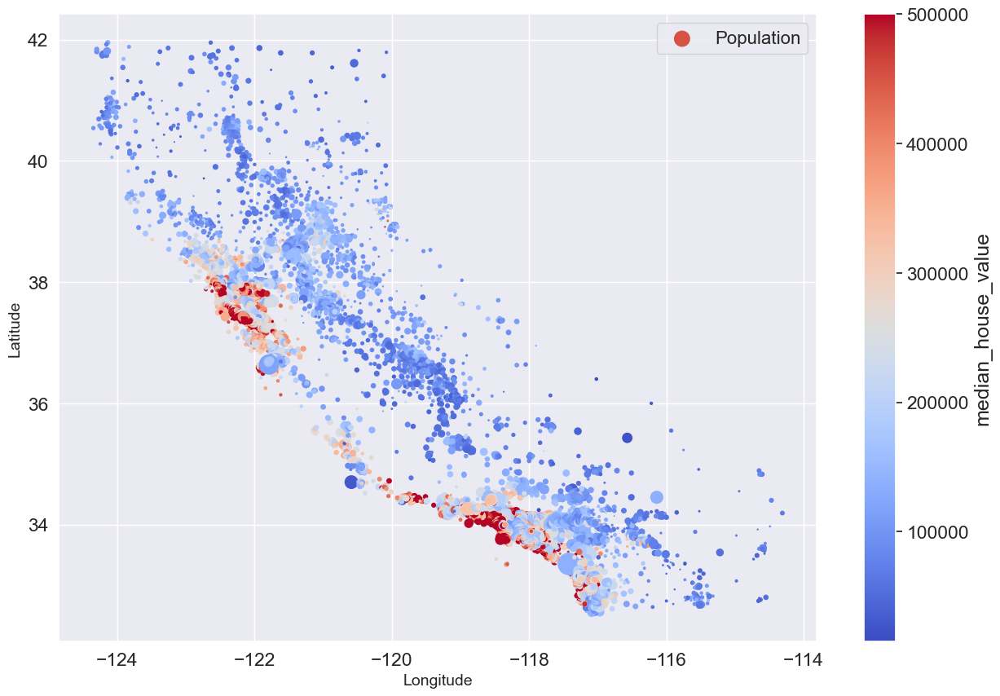

In [63]:
# (3)We can also define a color for the districts depending on the median house value.
# We select the color map, a cool warm, and we pass the true to the color bar parameter to create
# a color bar. 
df.plot(kind = "scatter", x = "longitude", y = "latitude", figsize = (15, 10),
       s = df["population"]/100, label = "Population",
       c = "median_house_value", cmap = "coolwarm", colorbar = True)
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)
plt.show()

The dark red indicates house prices of roundabout 500,000 and dark blue indicates the prices of
roundabout 100,000

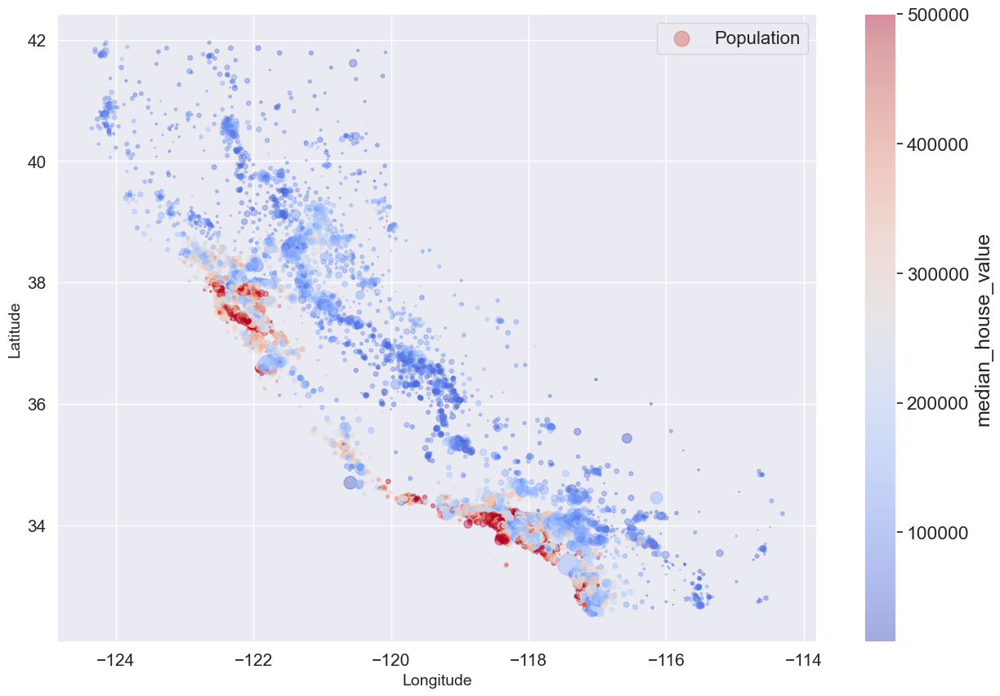

In [64]:
df.plot(kind="scatter", x="longitude", y="latitude",
                       s=df.population/100, label="Population", figsize = (15, 10),
                       c="median_house_value", cmap= "coolwarm",
                       colorbar=True, alpha=0.4, fontsize = 15, sharex = False)
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)

plt.show()

Now, if we have a closer look at our graph here, then this looks like the shape of California and it would be helpful to have somehow also California map here included:

In [9]:
import matplotlib.image as mpimg
california_img = mpimg.imread("./data/california.png")

So each and every image can be represented by a matrix array:

In [10]:
california_img

array([[[0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        ...,
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.6666667, 1.       ]],

       [[0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        ...,
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.6666667, 1.       ]],

       [[0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        [0.627451 , 0.7764706, 0.9137255, 1.       ],
        ...,
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.6666667, 1.       ],
        [0.9647059, 0.827451 , 0.666666

We can also display the image:

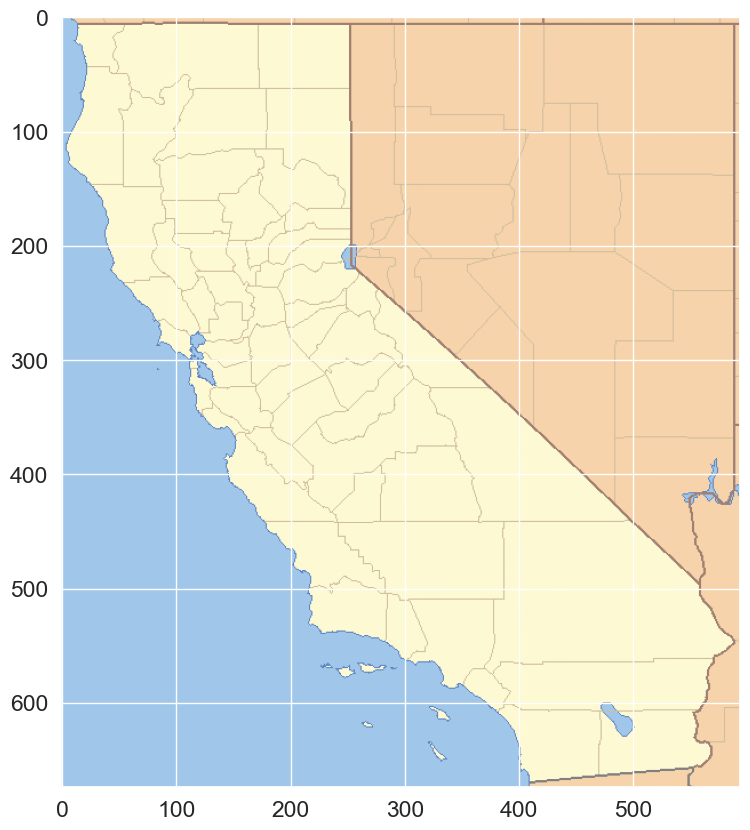

In [67]:
plt.figure(figsize = (15, 10))
plt.imshow(california_img)
plt.show()

Unfortunately, we do not have the longitude latitude here on the axis. But we can add these:

In [68]:
df[["longitude", "latitude"]].describe().loc[("min", "max"), :]

,longitude,latitude
min,-124.35,32.54
max,-114.31,41.95


But we would not use our coordinates from the DataFrame and use coordinates for California state:

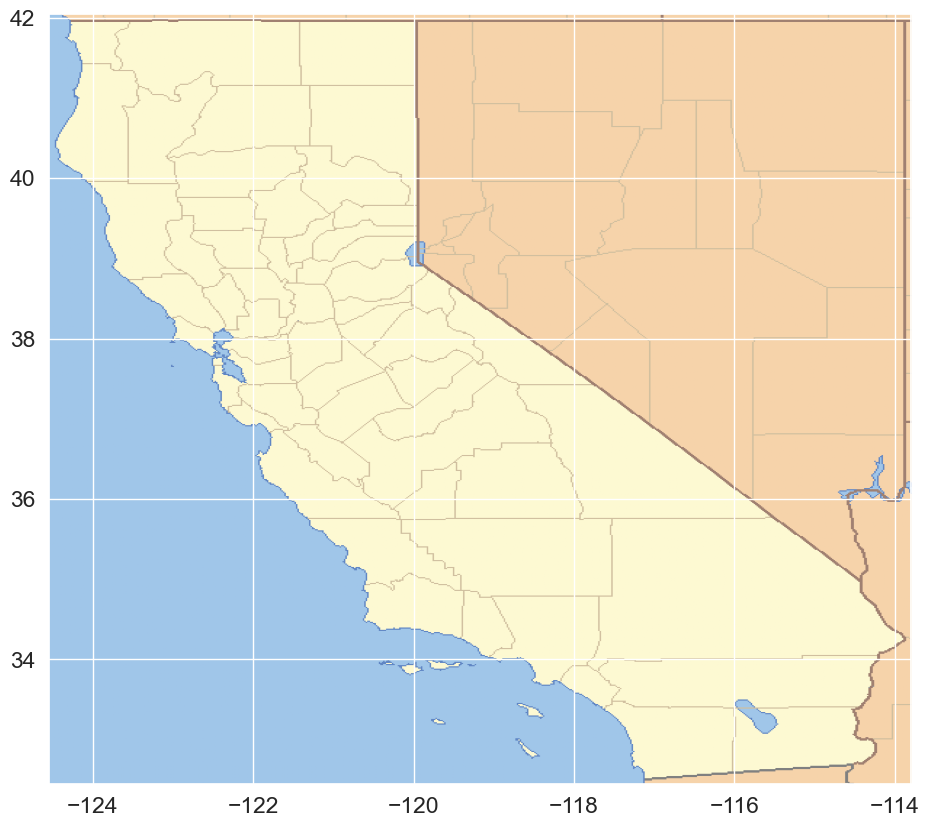

In [69]:
plt.figure(figsize = (15, 10))
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05])
plt.show()

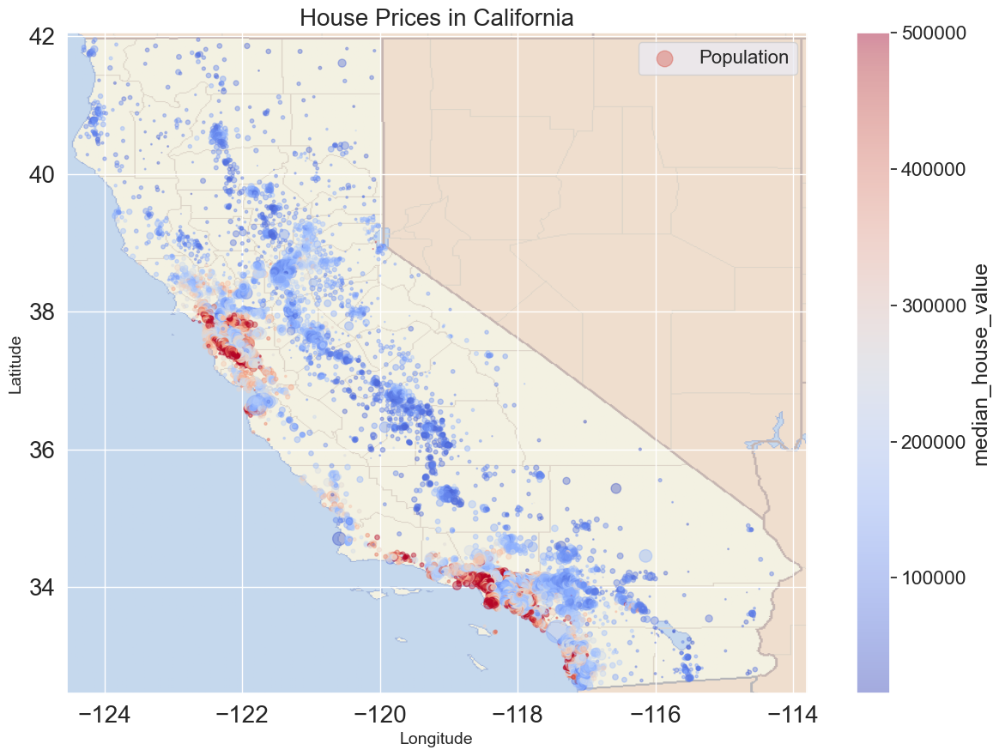

In [70]:
df.plot(kind="scatter", x="longitude", y="latitude",
                       s=df.population/100, label="Population", figsize = (15, 10),
                       c="median_house_value", cmap="coolwarm",
                       colorbar=True, alpha=0.4, fontsize = 20, sharex = False)
                      
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))

plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.title("House Prices in California", fontsize = 20)
plt.legend(fontsize=16)
plt.show()

We can clearly see that the more expensive houses and the more expensive districts are near the ocean. The inland, the houses are getting more affordable with prices around about 100,000.

We also have the categorical feature, ocean proximity, and let's get the unique values. So we have five different categories nearby, less than one hour to the ocean inland near the ocean
and island.

In [71]:
prox = df.ocean_proximity.unique()
prox

array(['NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND'],
      dtype=object)

Let's create the plot here only for the near ocean districts:

In [72]:
df_loc = df[df.ocean_proximity == prox[3]].copy()

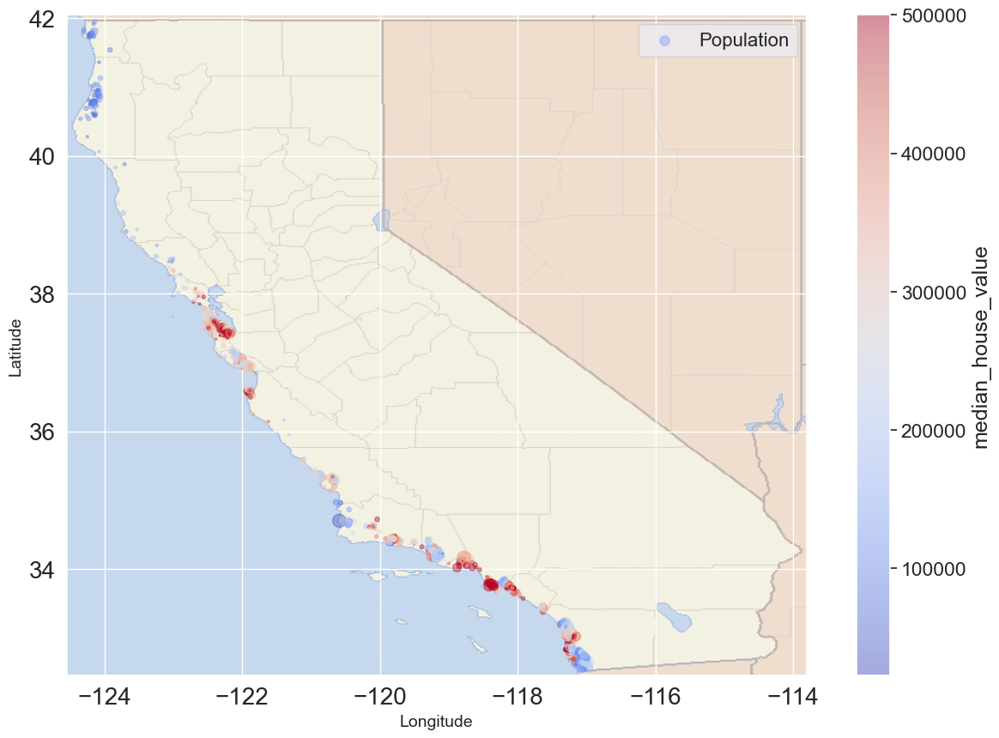

In [73]:
df_loc.plot(kind="scatter", x="longitude", y="latitude",
                       s=df_loc['population']/100, label="Population", figsize = (15, 10),
                       c="median_house_value", cmap="coolwarm",
                       colorbar=True, alpha=0.4, fontsize = 20, sharex = False
                      )
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))

plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)
plt.show()

In [74]:
df_loc = df[df.ocean_proximity == prox[2]].copy()

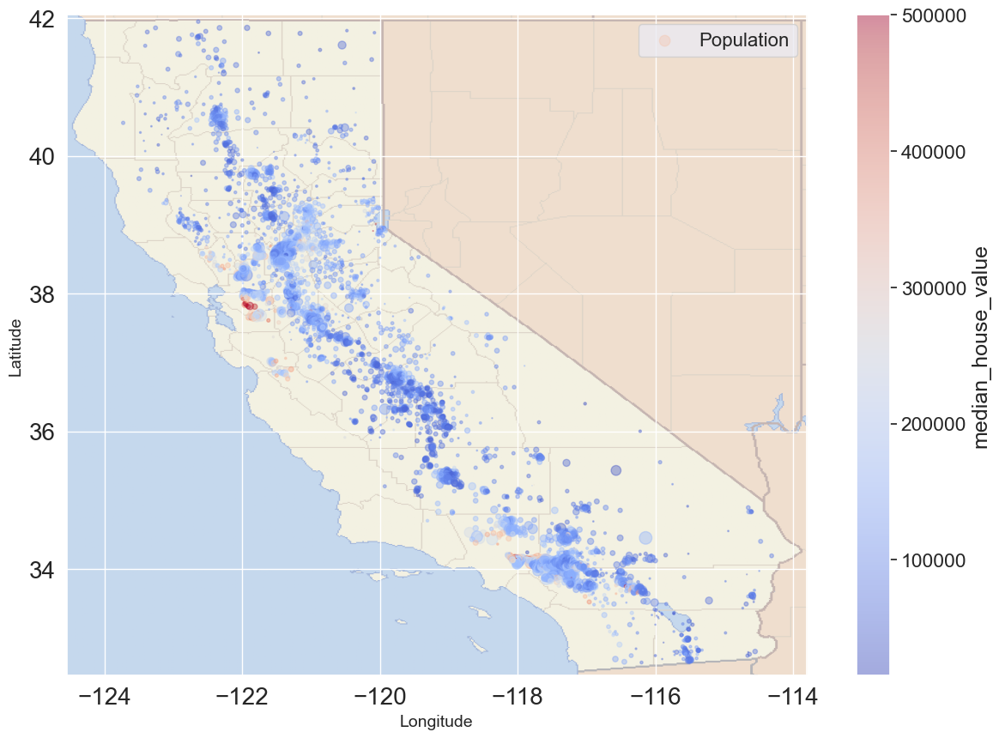

In [75]:
df_loc.plot(kind="scatter", x="longitude", y="latitude",
                       s=df_loc['population']/100, label="Population", figsize = (15, 10),
                       c="median_house_value", cmap="coolwarm",
                       colorbar=True, alpha=0.4, fontsize = 20, sharex = False
                      )
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))

plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)
plt.legend(fontsize=16)
plt.show()

We could conclude that location matters for house prices but it is not a linear relationship.

In [76]:
correlation_matrix.loc[("longitude", "latitude"), :]

,median_house_value
longitude,-0.045398
latitude,-0.144638


With a non-linear machine learning model like the random forest regressor, we should be able to capture the relationship between location and house prices.

#### Plot showing the geographical distribution of median house values in California, with the size of each point representing the population of the district. Using Folium module and interactive Leaflet.js map

In [77]:
import folium

Folium is a Python library that's primarily built on top of the Leaflet.js library, which is an open-source JavaScript library for mobile-friendly interactive maps. Folium makes it easy to visualize data that's been manipulated in Python on an interactive Leaflet map.

While Folium maps can resemble Google Maps in terms of their functionality and appearance, they are not directly based on Google Maps. Instead, Folium provides various tilesets for the map background, including OpenStreetMap (which is the default), Mapbox, and Stamen Terrain, among others. Users can also add custom tilesets or even Google Maps tiles by specifying the tile URL, but this is not the default behavior and might require additional considerations like API keys and usage policies.

Folium's integration with Leaflet.js allows for a wide range of interactive features, such as zoom controls, markers, overlays, and more, making it a powerful tool for geographic data visualization within the Python ecosystem. Its ability to integrate with Python data manipulation tools like Pandas makes it particularly useful for data science and analysis tasks.

In [78]:
# Create a base map centered around California
california_map = folium.Map(location=[36.7783, -119.4179], zoom_start=6) 
california_map

To address the issues you've mentioned — adding a colormap for `median_house_value` and varying the size of the dots based on the `population` without overlapping city names — we can make a few adjustments:

1. **Colormap for `median_house_value`**: Instead of using a binary color scheme (red and blue), we can use a continuous colormap to represent the range of `median_house_value`. `folium` doesn't directly support adding a colormap legend for `CircleMarker` points, but we can create a custom legend to approximate this.

2. **Varying Dot Sizes**: To ensure that the dot sizes represent the population without causing too much overlap, we'll need to fine-tune the scaling factor for the population size. We should also consider setting a maximum size to prevent the largest circles from covering too much of the map.

3. **Overlapping City Names**: Reducing the maximum size of the dots and ensuring they're not too opaque can help with this issue. Unfortunately, because `folium` generates a static overlay on top of the map tiles, we have limited control over the interaction between the map's features (like city names) and our data points. Choosing an appropriate zoom level and dot size is key.

Here's an example incorporating the code:

In [79]:
import folium
from branca.colormap import LinearColormap

# Create a base map centered around California
california_map = folium.Map(location=[36.7783, -119.4179], zoom_start=6)

custom_colormap = LinearColormap(['blue', 'orange', 'red', 'cyan', 'magenta', 'lime'],
                                 vmin=df['median_house_value'].min(),
                                 vmax=df['median_house_value'].max())

# Add points to the map with custom colors based on 'median_house_value'
for _, row in df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        # popup=f"Lat: {row['latitude']}, Lon: {row['longitude']}", # show coordinates by clicking the mouse
        radius=max(1, row['population'] / 4000),  # Adjust the scaling for population
        color=custom_colormap(row['median_house_value']),
        fill=True,
        fill_opacity=0.7,
        weight=0  # Remove the circle outline
    ).add_to(california_map)

# Add the custom colormap to the map as a legend
custom_colormap.caption = 'Median House Value'
california_map.add_child(custom_colormap)

# Display the map
california_map


In this code, we use `branca.colormap` to create a continuous colormap, which we then apply to the color of each `CircleMarker` based on the `median_house_value`. We scale the radius of the circles based on the `population` and set a minimum size to ensure visibility. The `weight=0` parameter removes the circle outline, reducing visual clutter and helping to mitigate the overlap issue.

Please note that due to the limitations of static maps and the density of points, some overlap with map features like city names may be unavoidable, especially in densely populated areas. Experimenting with the zoom level, circle sizes, and opacity can help find a balance that works for your specific data and visualization needs.

To display a Folium map in a browser, you can use the `.save()` method to save the map to an HTML file and then open that file in your default web browser. This method is straightforward and works well for sharing your map with others or viewing it outside of a Jupyter notebook or Python script environment.

Here's how you can modify the previous example to save the map to an HTML file and then open it in a browser:

In [80]:
# Save the map to an HTML file
california_map.save('house_values_california_map.html')

In [81]:
import webbrowser
# Open the saved HTML file in the default web browser
webbrowser.open('house_values_california_map.html', new=2)

True

In this code snippet:

- After customizing the map (adding markers, layers, layer control, etc.), use the `.save()` method on your `folium.Map` object, passing the desired file path for the HTML file.
- The `webbrowser.open()` function is used to open the specified HTML file in the default web browser. The `new=2` argument attempts to open the file in a new tab if possible.

This approach generates a standalone HTML file containing your interactive map, which can be easily shared and viewed in any modern web browser. The map's interactivity, including zoom controls, layer toggling, and marker popups, will be fully functional in the browser, just as it is in a Jupyter notebook.

To plot only the data points where ocean_proximity is "NEAR OCEAN", we can filter your DataFrame to include only those rows and then plot the filtered data on the map. Here's how you can do it:

In [82]:
df.ocean_proximity.value_counts()

ocean_proximity
<1H OCEAN     9034
INLAND        6496
NEAR OCEAN    2628
NEAR BAY      2270
ISLAND           5
Name: count, dtype: int64

In [83]:
import folium
from branca.colormap import LinearColormap

# Filter the DataFrame to include only rows where ocean_proximity 
df_customized = df[df['ocean_proximity'] == 'NEAR OCEAN']

# Create a base map centered around California with adjusted size
california_map = folium.Map(location=[36.7783, -119.4179], 
                            zoom_start=6, 
                            width='75%',  # Adjust width as a percentage of the parent container
                            height='50%')  # Adjust height as a percentage of the parent container

custom_colormap = LinearColormap(['blue', 'orange', 'red', 'cyan', 'magenta', 'lime'],
                                 vmin=df['median_house_value'].min(),
                                 vmax=df['median_house_value'].max())

# Add points to the map with custom colors based on 'median_house_value'
for _, row in df_customized.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        # popup=f"Lat: {row['latitude']}, Lon: {row['longitude']}", # show coordinates by clicking the mouse
        radius=max(1, row['population'] / 4000),  # Adjust the scaling for population
        color=custom_colormap(row['median_house_value']),
        fill=True,
        fill_opacity=0.7,
        weight=0  # Remove the circle outline
    ).add_to(california_map)

# Add the custom colormap to the map as a legend
custom_colormap.caption = 'Median House Value'
california_map.add_child(custom_colormap)

# Display the map
california_map


### (5.5) Explore "ocean_proximity" and "median_house_value" relationship using barplot

We can also create a seaborne bar plot where we have on the x axis ocean proximity and on the Y axis he median house value.

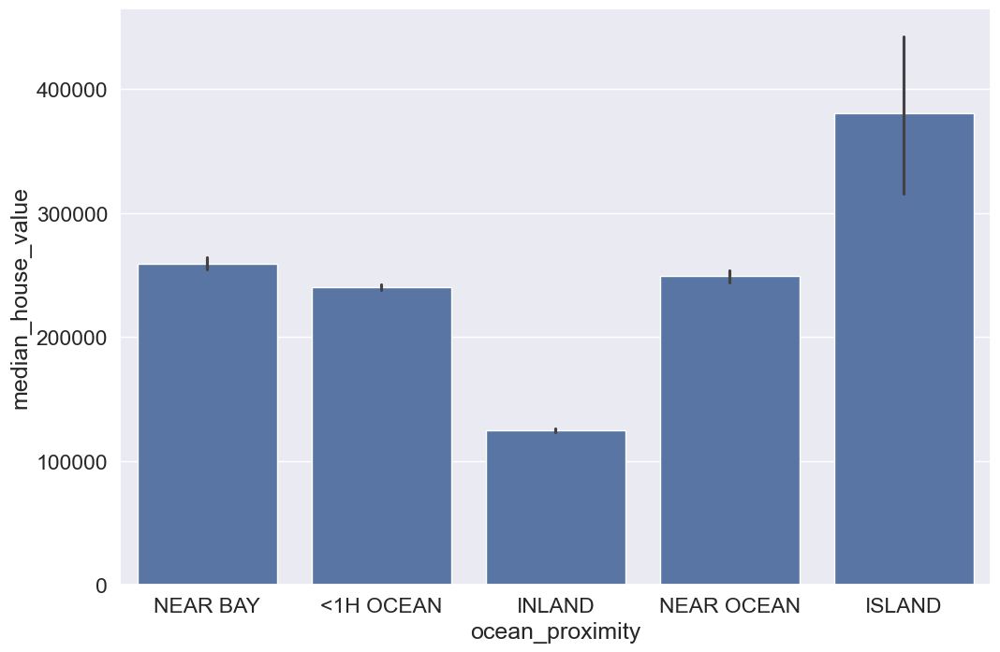

In [84]:
plt.figure(figsize=(12,8))
sns.set(font_scale=1.5)
sns.barplot(data = df, x = "ocean_proximity", y = "median_house_value", dodge = True)
plt.show()

We could ignore island because here we have only five districts and finally we have inland and the median house value of districts that are located in the inland are clearly lower than districts near the ocean.

As a side note, the height of the bars are point estimates for the average median house value, and the small black lines show the 95% confidence intervals.

Simplify things, we could also merge the categories nearby one hour to the ocean and near the ocean into one category. But let's leave it as it is here.

### (5.6) Explore "income_cat" and "ocean_proximity" relationship using heatmap

We could group by the income category and by the ocean proximity. So these are the two categorical features. Then we calculate the average value in the median house value. Then we unstack and we drop the island because this is not really meaningful.

Here we have only five observations and we save the resulting matrix in the variable matrix and we transform the floats into integers.

So this makes it easier to display the median income in our following heatmap.

In [85]:
matrix = df.groupby(["income_cat", "ocean_proximity"], observed=True).median_house_value.mean().unstack().drop(columns = ["ISLAND"])

In [86]:
matrix

ocean_proximity,<1H OCEAN,INLAND,NEAR BAY,NEAR OCEAN
income_cat,,,,
Low,161337.076923,84820.626650,155122.052133,148027.826514
Below_Average,197236.013829,115124.088283,220196.177656,208665.190096
Above_Average,232278.358759,147846.891351,261965.251582,255293.813584
High,292208.766217,208095.566622,322566.033663,337446.227778
Very High,439784.235489,347571.736842,451015.078788,468739.723270


In [87]:
matrix.astype("int")

ocean_proximity,<1H OCEAN,INLAND,NEAR BAY,NEAR OCEAN
income_cat,,,,
Low,161337,84820,155122,148027
Below_Average,197236,115124,220196,208665
Above_Average,232278,147846,261965,255293
High,292208,208095,322566,337446
Very High,439784,347571,451015,468739


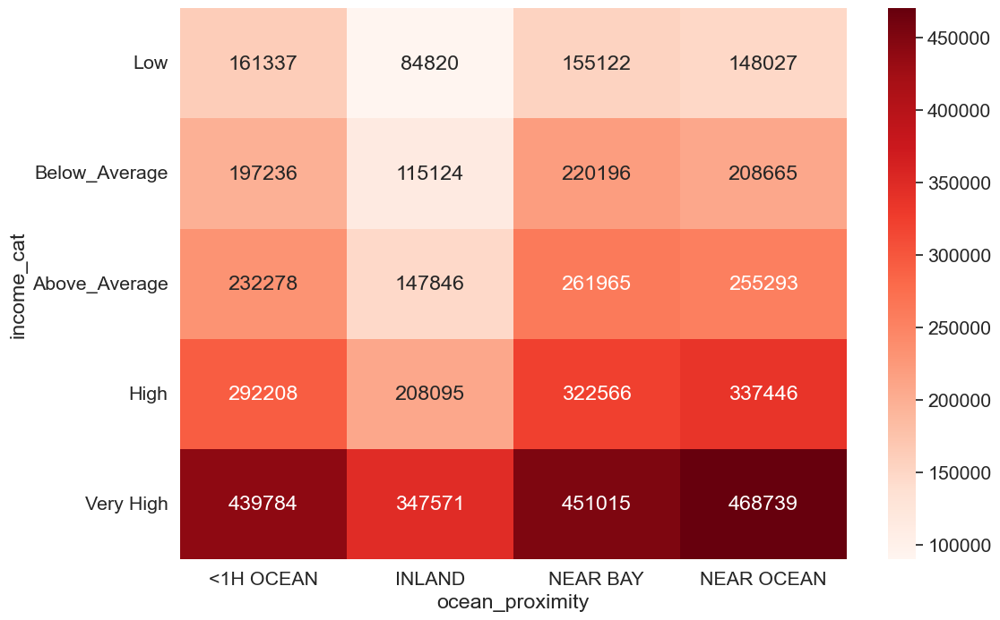

In [88]:
plt.figure(figsize=(12,8))
sns.set(font_scale=1.4)
sns.heatmap(matrix.astype("int"), cmap = "Reds", annot = True, fmt = "d", vmin = 90000, vmax = 470000)
plt.show()

So we create a seaborn heatmap. So we have on the x-axis the ocean proximity and on the Y-axis, the income categories. And we have actually here a color bar or a color map with the reds. The light red means that the income, the medium income is around about 100,000. And dark red stands for a median income of 450,000 or more.

So we use the color map reds, and we actually also annotated the values here by passing through to
the annot parameter. 

We scaled the color map in a way that we have the minimum values. So very light red at 90,000 and the maximum value at 470,000.

It's no surprise that we can find the highest House values in districts where we have a combination of very high income and a location near the ocean. We have the lowest income in the combination inland and the low income.

Also we can see that there's no big difference between the categories -one hour to the ocean, near bay, and near ocean. However, we can clearly see the difference of those three categories to the category inland.

Now we know a lot about our data and the relationships between features and label. Now, we are best prepared to create our machine learning model.

## (6) Feature Engineering - Part 2

### (6.1) Seperating features and label

In [89]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20433 entries, 0 to 20432
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   longitude            20433 non-null  float64 
 1   latitude             20433 non-null  float64 
 2   housing_median_age   20433 non-null  float64 
 3   total_rooms          20433 non-null  float64 
 4   total_bedrooms       20433 non-null  float64 
 5   population           20433 non-null  float64 
 6   households           20433 non-null  float64 
 7   median_income        20433 non-null  float64 
 8   median_house_value   20433 non-null  float64 
 9   ocean_proximity      20433 non-null  object  
 10  rooms_per_household  20433 non-null  float64 
 11  pop_per_household    20433 non-null  float64 
 12  bedrooms_per_room    20433 non-null  float64 
 13  income_cat           20433 non-null  category
dtypes: category(1), float64(12), object(1)
memory usage: 2.0+ MB


First of all, now it's time to separate features and labels. So we shouldn't transform the label house price because we want to forecast that prices and therefore we select the column median house value and create a separate object and save the object in the variable label.

In [90]:
label = df.median_house_value.copy()
label

0        452600.0
1        358500.0
2        352100.0
3        341300.0
4        342200.0
           ...   
20428     78100.0
20429     77100.0
20430     92300.0
20431     84700.0
20432     89400.0
Name: median_house_value, Length: 20433, dtype: float64

Then we get the features by dropping the column Median house value from DF.

In [91]:
features = df.drop(columns = ["median_house_value"])
features

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room,income_cat
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,NEAR BAY,6.984127,2.555556,0.146591,Very High
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,NEAR BAY,6.238137,2.109842,0.155797,Very High
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,NEAR BAY,8.288136,2.802260,0.129516,High
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,NEAR BAY,5.817352,2.547945,0.184458,High
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,NEAR BAY,6.281853,2.181467,0.172096,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20428,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,INLAND,5.045455,2.560606,0.224625,Low
20429,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,INLAND,6.114035,3.122807,0.215208,Low
20430,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,INLAND,5.205543,2.325635,0.215173,Low
20431,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,INLAND,5.329513,2.123209,0.219892,Low


### (6.2) Feature Scaling

Now let's focus on numerical features. In some cases, it's not the best solution to keep the numerical features as they are.
So typically, numerical features have very different scales. For instance, we have different scales in the columns population and the median income. One is scaled in thousands and the other between 1 and 15.

Normalizing data using the z-score is considered a part of feature engineering, specifically within the realm of feature scaling. Feature scaling is a technique to standardize the independent variables of the dataset within a specific range. In many machine learning algorithms, particularly those that compute distances or assume normality, having features on a similar scale can significantly improve performance.

The z-score normalization is a technique where the values of a feature are normalized based on the mean (μ) and standard deviation (σ) of the feature. The formula for calculating the z-score of a value is:

$$z = \frac{(x - \mu)}{\sigma} \$$

Where:
- $\( x \$) is the original value,
- \$( \mu \$) is the mean of the feature, and
- \$( \sigma \$) is the standard deviation of the feature.

This process transforms the feature such that its mean (μ) becomes 0 and its standard deviation (σ) becomes 1. This transformation doesn't change the distribution of the feature; if the feature is normally distributed before normalization, it will remain normally distributed after normalization.

**The benefits of z-score normalization include:**

1. **Improving Algorithm Performance**: Many algorithms, like K-nearest neighbors (KNN), support vector machines (SVM), and gradient descent-based algorithms (like linear regression and neural networks), perform better when the input features are on a similar scale.

2. **Faster Convergence**: In optimization algorithms, having features on the same scale can speed up the convergence of the algorithm, making the training process faster.

3. **Balanced Feature Influence**: It ensures that no single feature will dominate due to its scale, making the model more balanced and potentially improving its generalizability to new data.

However, **it's important to note that z-score normalization assumes that the feature's distribution is approximately normal**. In cases where the distribution is not normal, especially if there are outliers, this method can be less effective, and **other scaling techniques like Min-Max scaling or robust scaling might be more appropriate**.

Checking if features distirbution are normal so we can use z-score normalization:

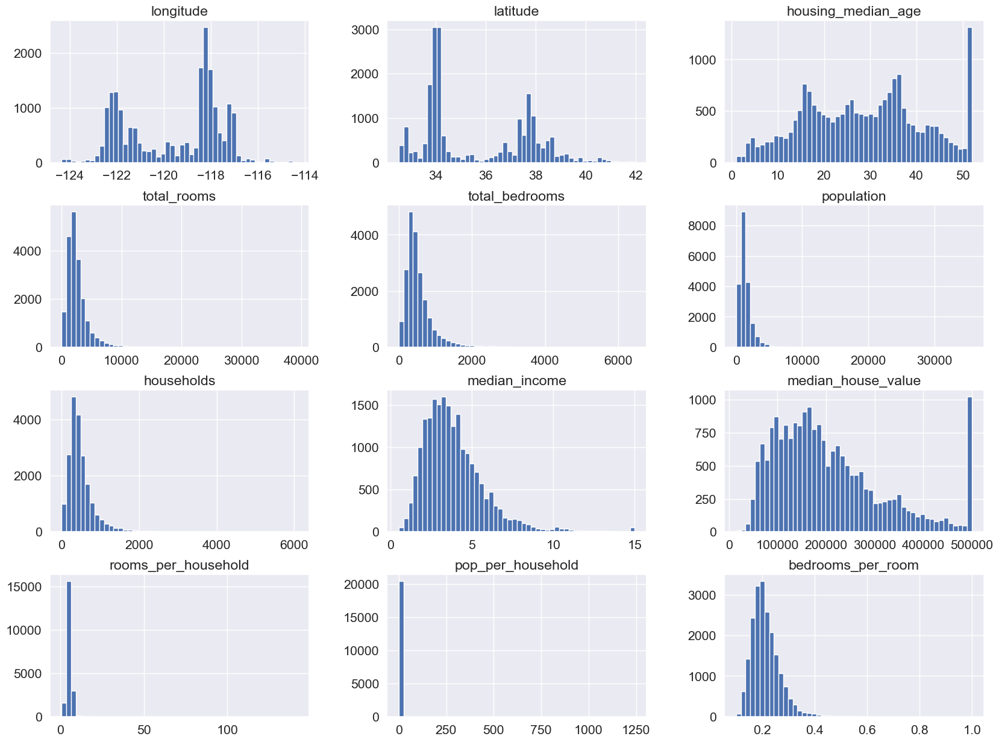

In [92]:
df.hist(bins=50, figsize=(20,15))
plt.show()

Shapiro-Wilk Test: This test specifically checks for normality. The null hypothesis is that the data is normally distributed. A significant p-value (typically <0.05) suggests that the null hypothesis can be rejected, indicating that the data is not normally distributed.

In [93]:
from scipy import stats

#Initialize a dictionary to hold the Shapiro-Wilk test results
shapiro_results = {}

# Iterating over each column in the DataFrame and performing the Shapiro-Wilk test
for column in features.select_dtypes("float").columns:
    stat, p_value = stats.shapiro(features.select_dtypes("float")[column])
    shapiro_results[column] = {'Statistic': stat, 'p-value': p_value}

# Convert the results dictionary to a DataFrame for better readability
shapiro_results_df = pd.DataFrame(shapiro_results).T
shapiro_results_df

/home/pavlo/Documents/Projects/Pandas/.venv/lib/python3.10/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 20433.
  res = hypotest_fun_out(*samples, **kwds)


,Statistic,p-value
longitude,0.896972,6.723501e-78
latitude,0.877138,7.618873e-82
housing_median_age,0.978180,2.009493e-47
total_rooms,0.693870,6.650043e-104
total_bedrooms,0.735021,3.085967e-100
population,0.712039,2.426854e-102
households,0.745194,2.965384e-99
median_income,0.893465,1.216384e-78
rooms_per_household,0.424062,9.588834e-121
pop_per_household,0.015891,4.999750e-136


The primary decision criterion for the Shapiro-Wilk test, and indeed most statistical hypothesis tests, is the p-value.

Here’s how the p-value is typically interpreted in this context:

- **Low p-value (typically ≤ 0.05)**: There's strong evidence against the null hypothesis, leading us to reject it. This suggests that the data does not follow a normal distribution.
- **High p-value (typically > 0.05)**: There's not enough evidence against the null hypothesis, so we fail to reject it. This implies that the data could be normally distributed.

The threshold (often called the alpha level) at which the p-value is considered low enough to reject the null hypothesis can vary depending on the field of study or specific research question, but 0.05 is a common standard.

The Shapiro-Wilk test results provided above indicate that none of our features are normally distributed, as all the p-values are significantly lower than the common alpha level of 0.05. 

The warning about the p-value accuracy for N > 5000 is important to note. The Shapiro-Wilk test's accuracy in computing p-values decreases with large sample sizes, which means the extremely small p-values should be interpreted with caution. However, the overall trend clearly indicates non-normality.

Given these results, when working with machine learning models or statistical methods that assume normality, you might need to consider:

1. **Transformation**: Applying transformations (log, square root, Box-Cox, etc.) to attempt to normalize the distributions.
2. **Alternative Models**: Using models that do not assume normality. Many machine learning models, including tree-based models like Random Forests and gradient boosting machines, as well as non-parametric methods, can handle non-normal distributions effectively.
3. **Robust Scaling**: In cases where feature scaling is necessary (for some models), consider using scaling methods that are robust to non-normal distributions and outliers, such as RobustScaler in scikit-learn.

**Does it significanly improve performance having features on a similar scale For Random Forest Regressor Model?**

For Random Forest Regressor models, having features on a similar scale does not significantly improve performance in the same way it does for algorithms that rely on distance calculations, like K-Nearest Neighbors, or algorithms that are sensitive to the scale of input features, like Gradient Descent-based methods (e.g., linear regression, neural networks).

Random Forest is an ensemble learning method that operates by constructing multiple decision trees during the training process and outputting the mean or average prediction of the individual trees for regression tasks. Here are a few reasons why feature scaling is less critical for Random Forest models:

1. **Decision Trees**: Random Forest is based on decision trees, which are less sensitive to the scale of data. Decision trees split the data based on the feature values, making decisions at each node regarding which feature and which threshold value best separate the data into homogenous sets. These decisions are not influenced by the absolute scale of the feature values.

2. **Relative Ordering**: Decision trees only care about the order of the data and the thresholds that best divide the data at each node. Whether a feature's values range from 0 to 1 or 0 to 1000 doesn't change the way the trees will split that feature; it only affects the threshold values used for the splits.

3. **No Distance Calculation**: Algorithms like KNN and SVM, which are sensitive to feature scale, compute distances between data points as a core part of their function. Decision trees and, by extension, Random Forests do not compute distances; therefore, the scale of features has little to no effect on the model's ability to learn from those features.

That being said, while feature scaling might not significantly improve the performance of a Random Forest model, there are still some potential benefits to preprocessing your data:

- **Interpretability**: Scaling features can sometimes make models more interpretable, especially when comparing the importance of features. Even though feature importance in Random Forests is not directly affected by feature scale, having all features on a similar scale can make these comparisons more intuitive.

- **Convergence in Embedded Models**: If your Random Forest model is part of a larger pipeline that includes algorithms sensitive to feature scale, scaling might be necessary.

- **Outlier Sensitivity**: Although Random Forest can handle outliers to a certain extent, extremely large or small values can still influence tree structure in ways that might not be ideal. Scaling can mitigate extreme outliers' influence on the model.

**In summary**, while feature scaling is not a requirement for Random Forest models and generally does not significantly impact their performance, it might still be beneficial depending on the broader context of your data and modeling pipeline.

Although for the model we are planning to use, Random Forrest Regressor, having features on a similar scale doesn't significantly improve performance we will still go ahead with feature scaling use z-score normalization. Z-score normalization is not the best normalization method as our feature are not normally distributed. In the future, we better apply transformations like(Min-Max scaling, robust scaling, log, square root, Box-Cox, etc.) to attempt to normalize the distributions.

In [94]:
features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20433 entries, 0 to 20432
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype   
---  ------               --------------  -----   
 0   longitude            20433 non-null  float64 
 1   latitude             20433 non-null  float64 
 2   housing_median_age   20433 non-null  float64 
 3   total_rooms          20433 non-null  float64 
 4   total_bedrooms       20433 non-null  float64 
 5   population           20433 non-null  float64 
 6   households           20433 non-null  float64 
 7   median_income        20433 non-null  float64 
 8   ocean_proximity      20433 non-null  object  
 9   rooms_per_household  20433 non-null  float64 
 10  pop_per_household    20433 non-null  float64 
 11  bedrooms_per_room    20433 non-null  float64 
 12  income_cat           20433 non-null  category
dtypes: category(1), float64(11), object(1)
memory usage: 1.9+ MB


In [95]:
features

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,pop_per_household,bedrooms_per_room,income_cat
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,NEAR BAY,6.984127,2.555556,0.146591,Very High
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,NEAR BAY,6.238137,2.109842,0.155797,Very High
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,NEAR BAY,8.288136,2.802260,0.129516,High
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,NEAR BAY,5.817352,2.547945,0.184458,High
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,NEAR BAY,6.281853,2.181467,0.172096,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20428,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,INLAND,5.045455,2.560606,0.224625,Low
20429,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,INLAND,6.114035,3.122807,0.215208,Low
20430,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,INLAND,5.205543,2.325635,0.215173,Low
20431,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,INLAND,5.329513,2.123209,0.219892,Low


In [96]:
features.select_dtypes("float") # selecting columns with float values

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,6.984127,2.555556,0.146591
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,6.238137,2.109842,0.155797
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,8.288136,2.802260,0.129516
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,5.817352,2.547945,0.184458
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,6.281853,2.181467,0.172096
...,...,...,...,...,...,...,...,...,...,...,...
20428,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,5.045455,2.560606,0.224625
20429,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,6.114035,3.122807,0.215208
20430,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,5.205543,2.325635,0.215173
20431,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,5.329513,2.123209,0.219892


In [97]:
import scipy.stats as stats

In [98]:
feature_zscore = features.select_dtypes("float").apply(lambda x: stats.zscore(x))
feature_zscore

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room
0,-1.327314,1.051717,0.982163,-0.803813,-0.970325,-0.973320,-0.976833,2.345163,0.625395,-0.049433,-1.146024
1,-1.322323,1.042355,-0.606210,2.042130,1.348276,0.861339,1.670373,2.332632,0.324942,-0.092134,-0.987254
2,-1.332305,1.037674,1.855769,-0.535189,-0.825561,-0.819769,-0.843427,1.782939,1.150594,-0.025797,-1.440514
3,-1.337296,1.037674,1.855769,-0.623510,-0.718768,-0.765056,-0.733562,0.932970,0.155467,-0.050162,-0.492925
4,-1.337296,1.037674,1.855769,-0.461970,-0.611974,-0.758879,-0.628930,-0.013143,0.342549,-0.085272,-0.706141
...,...,...,...,...,...,...,...,...,...,...,...
20428,-0.758318,1.800677,-0.288535,-0.444580,-0.388895,-0.511787,-0.443207,-1.216727,-0.155420,-0.048949,0.199820
20429,-0.818212,1.805358,-0.844466,-0.887557,-0.920488,-0.943315,-1.008223,-0.692044,0.274959,0.004912,0.037412
20430,-0.823203,1.777272,-0.923885,-0.175042,-0.125472,-0.368826,-0.173778,-1.143171,-0.090943,-0.071460,0.036808
20431,-0.873115,1.777272,-0.844466,-0.355344,-0.305834,-0.603564,-0.393506,-1.055136,-0.041013,-0.090853,0.118204


In [99]:
pd.options.display.float_format = '{:.2f}'.format

In [100]:
feature_zscore.agg(["mean", "std"])

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room
mean,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


Now here we can see that the mean value in each and every column is zero and the standard deviation one.
That's exactly the definition of standardizing features. So we get a mean of zero and a standard deviation of one.
As a consequence, all features have now the very same scale.

### (6.3) Categorical data Encoding

Typically machine learning algorithms cannot handle text data and therefore we have to transform texts or categorical data into numbers.

In our dataset we have two categorical features, that are ocean_proximity and income_cat. However, in our final model we only use the ocean proximity feature.

In [101]:
features.ocean_proximity

0        NEAR BAY
1        NEAR BAY
2        NEAR BAY
3        NEAR BAY
4        NEAR BAY
           ...   
20428      INLAND
20429      INLAND
20430      INLAND
20431      INLAND
20432      INLAND
Name: ocean_proximity, Length: 20433, dtype: object

In [102]:
features.ocean_proximity.value_counts()

ocean_proximity
<1H OCEAN     9034
INLAND        6496
NEAR OCEAN    2628
NEAR BAY      2270
ISLAND           5
Name: count, dtype: int64

Now we can transform this categorical feature into numbers with so called **One-Hot Encoding**. For each and every category, we create a new feature or column with binary values 1 or 0. So these are also called dummy variables or dummy features, and we can create those as follows:

In [103]:
dummies = pd.get_dummies(features.ocean_proximity, dtype=int)
dummies

,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN
0,0,0,0,1,0
1,0,0,0,1,0
2,0,0,0,1,0
3,0,0,0,1,0
4,0,0,0,1,0
...,...,...,...,...,...
20428,0,1,0,0,0
20429,0,1,0,0,0
20430,0,1,0,0,0
20431,0,1,0,0,0


Now, there's one issue that we should keep in mind. If we keep all five features, then one is actually redundant.
So once we know the value in four columns, then we automatically know also the value in the fifth column.
So if we have a look here at the first four columns, then we can see that we already have the value one.

And then it's pretty clear that in the last column we have the value zero because we can only have the
value one in exactly one column. So if we are working with all five dummy variables, so to say we have the information twice in our
data and this can cause the so-called multicollinearity problem and actually some algorithms are sensitive to and can be harmed by multicollinearity like linear regression and for instance, if we use a linear regression, then we should delete the one feature and only use the K minus one. So in our example, five minus one is equal to four features. So we have to delete the one of these columns here.

However, when we use other models, like for instance, a random forest regression, it can be beneficial to keep all five or all K features in our dataset.

Now let's go on and let's merge our features again into one feature dataframe

In [104]:
features = pd.concat([feature_zscore, dummies, df.income_cat], axis = 1)
features

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,income_cat
0,-1.33,1.05,0.98,-0.80,-0.97,-0.97,-0.98,2.35,0.63,-0.05,-1.15,0,0,0,1,0,Very High
1,-1.32,1.04,-0.61,2.04,1.35,0.86,1.67,2.33,0.32,-0.09,-0.99,0,0,0,1,0,Very High
2,-1.33,1.04,1.86,-0.54,-0.83,-0.82,-0.84,1.78,1.15,-0.03,-1.44,0,0,0,1,0,High
3,-1.34,1.04,1.86,-0.62,-0.72,-0.77,-0.73,0.93,0.16,-0.05,-0.49,0,0,0,1,0,High
4,-1.34,1.04,1.86,-0.46,-0.61,-0.76,-0.63,-0.01,0.34,-0.09,-0.71,0,0,0,1,0,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20428,-0.76,1.80,-0.29,-0.44,-0.39,-0.51,-0.44,-1.22,-0.16,-0.05,0.20,0,1,0,0,0,Low
20429,-0.82,1.81,-0.84,-0.89,-0.92,-0.94,-1.01,-0.69,0.27,0.00,0.04,0,1,0,0,0,Low
20430,-0.82,1.78,-0.92,-0.18,-0.13,-0.37,-0.17,-1.14,-0.09,-0.07,0.04,0,1,0,0,0,Low
20431,-0.87,1.78,-0.84,-0.36,-0.31,-0.60,-0.39,-1.06,-0.04,-0.09,0.12,0,1,0,0,0,Low


### (6.4) Balance between using dedicated preprocessing tools in libraries like `scikit-learn` to create a permanently running algorithm `VS` leveraging more general-purpose libraries like pandas and `scipy.stats` for data manipulation and analysis

Again, in case we are planning to create a permanently running algorithm, it definitely makes sense to use scikit learn pre-processing pipelines and to use scikit learn methods to engineer features. But I just want to highlight here that we can do most of the things also with Pandas and other libraries like Scipy.stats.

Creating a "permanently running algorithm" typically refers to developing a machine learning model or algorithmic solution that is deployed in a production environment where it continuously operates, making predictions or decisions based on new incoming data. This contrasts with a model that's run once or intermittently, perhaps for batch processing or ad-hoc analysis. 

I would like to highlighting the important aspect of data preprocessing in machine learning workflows, particularly the balance between using dedicated preprocessing tools in libraries like scikit-learn and leveraging more general-purpose libraries like pandas and scipy.stats for data manipulation and analysis.

**Using scikit-learn Preprocessing and Pipelines**

Scikit-learn offers a wide range of preprocessing functionalities and a pipeline mechanism that can streamline the process of preparing your data for machine learning models. The advantages of using scikit-learn's preprocessing tools and pipelines include:

- **Consistency**: By defining a preprocessing pipeline, you ensure that the same sequence of transformations is applied to your training data, validation data, and any new data that the model encounters.
- **Convenience**: Scikit-learn pipelines allow you to bundle together preprocessing steps (like scaling, encoding, and normalization) with model training in a way that reduces the risk of data leakage and simplifies your code.
- **Compatibility**: Scikit-learn's preprocessing tools are designed to integrate seamlessly with its machine learning models, making it easier to experiment with different models and preprocessing techniques.

**Using Pandas and Other Libraries**

While scikit-learn's preprocessing and pipeline tools are powerful, pandas and libraries like scipy.stats offer a wide range of data manipulation and analysis capabilities that can be essential for feature engineering and data preprocessing:

- **Flexibility**: Pandas is extremely versatile and allows for complex data manipulations that might be necessary for feature engineering. It provides a more flexible platform for data exploration and manipulation compared to the more structured approach of scikit-learn pipelines.
- **Statistical Functions**: Libraries like scipy.stats offer a broad array of statistical functions that can be used for more advanced feature engineering, such as applying statistical tests or transformations that are not directly available in scikit-learn.
- **Visualization**: Pandas integration with visualization libraries like Matplotlib and Seaborn makes it easier to explore and understand your data visually, which is a crucial part of the feature engineering process.

**Combining Both Approaches**

In practice, a combination of both approaches is often used. Pandas and scipy.stats can be utilized for initial data exploration, cleaning, and feature engineering, where their flexibility and range of functions are particularly valuable. After this initial phase, scikit-learn's preprocessing tools and pipelines can be used to standardize the preprocessing steps, making the workflow more consistent and less prone to errors, especially when the model is deployed or used to make predictions on new data.

I would like to emphasize the importance of understanding and leveraging the strengths of each set of tools in your data science toolkit, allowing for both the flexibility of pandas and scipy.stats in the exploration and feature engineering phases, and the consistency and integration benefits of scikit-learn's preprocessing and pipeline mechanisms in the model training and deployment phases.

## (7) Spliting the Data into Train and Test Set

Splitting the dataset into training and test sets is a fundamental practice in machine learning that helps in evaluating the performance of a model in an unbiased manner. Here's why it's important:

### 1. **Assessment of Generalization Ability**
- The primary goal is to assess how well the model can generalize to new, unseen data. The training set is used to fit the model, while the test set, which contains data the model hasn't seen during training, is used to evaluate how well the model performs on data outside of its training experience.

### 2. **Prevention of Overfitting**
- Overfitting occurs when a model learns the detail and noise in the training data to the extent that it performs well on the training data but poorly on new data. By evaluating the model on a separate test set, you can detect overfitting and take steps to mitigate it.

### 3. **Model Selection and Tuning**
- The test set provides a final, unbiased evaluation of the fully trained model. However, during the model development phase, you might also use a validation set (or cross-validation) to compare different models or tune hyperparameters. This helps in selecting the best model and hyperparameter settings without "using up" the test set. The test set is then used to give an unbiased evaluation of the final model selection.

### 4. **Estimation of Real-world Performance**
- The test set acts as a proxy for future data on which the model will make predictions. A good performance on the test set indicates that the model is likely to perform well on real-world data, assuming the test set is representative of the real-world scenario.

### 5. **Ensuring Data Integrity**
- Keeping a separate test set ensures that the assessment of the model's performance is fair and unbiased. If the same data is used for both training and testing, the performance metrics would not accurately reflect the model's ability to generalize to new data.

### Best Practices
- **Representativeness**: Both the training and test sets should be representative of the overall dataset to ensure that the model learns relevant patterns and is evaluated on a fair sample of data.
- **Random Sampling**: Data points should be randomly assigned to the training and test sets to prevent any systematic differences between the two sets.
- **Proportion**: Common splits include 70/30, 80/20, or 90/10 (training/test), depending on the size of the dataset. For very large datasets, a smaller proportion of data can be allocated to the test set.

By adhering to this practice, you ensure that the performance metrics you obtain from the test set are a good indicator of how the model will perform on new, unseen data, which is the ultimate goal of most machine learning projects.

Now the time has come to split our dataset into a training set and a test set because the only way to know how well our model will generalize to new cases is to try it out on new cases. We are going to train our machine learning model using the training set.Then we test the ability of our model to generalize and to forecast house prices for data points that our model has not seen before.

In [105]:
features

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,income_cat
0,-1.33,1.05,0.98,-0.80,-0.97,-0.97,-0.98,2.35,0.63,-0.05,-1.15,0,0,0,1,0,Very High
1,-1.32,1.04,-0.61,2.04,1.35,0.86,1.67,2.33,0.32,-0.09,-0.99,0,0,0,1,0,Very High
2,-1.33,1.04,1.86,-0.54,-0.83,-0.82,-0.84,1.78,1.15,-0.03,-1.44,0,0,0,1,0,High
3,-1.34,1.04,1.86,-0.62,-0.72,-0.77,-0.73,0.93,0.16,-0.05,-0.49,0,0,0,1,0,High
4,-1.34,1.04,1.86,-0.46,-0.61,-0.76,-0.63,-0.01,0.34,-0.09,-0.71,0,0,0,1,0,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20428,-0.76,1.80,-0.29,-0.44,-0.39,-0.51,-0.44,-1.22,-0.16,-0.05,0.20,0,1,0,0,0,Low
20429,-0.82,1.81,-0.84,-0.89,-0.92,-0.94,-1.01,-0.69,0.27,0.00,0.04,0,1,0,0,0,Low
20430,-0.82,1.78,-0.92,-0.18,-0.13,-0.37,-0.17,-1.14,-0.09,-0.07,0.04,0,1,0,0,0,Low
20431,-0.87,1.78,-0.84,-0.36,-0.31,-0.60,-0.39,-1.06,-0.04,-0.09,0.12,0,1,0,0,0,Low


**Lets create test set**  

We will use 80% of the data for training and to hold out the 20% for testing.

Normally the split proportion depends on the size of the dataset. So if we have millions of data points, it might be enough to have a test set of 1 or 2%. In our case, we have over 20,000 observations and here it makes sense to have a test size of 20%.

In [106]:
test_size = 0.2

Now the easiest way to split our dataset is by drawing a random sample using `.sample()` method. Let's create the test set or more accurate, the features of the test set. X stands for the features and Y for the label, and we save it in the variable capital X test:

In [107]:
X_test = features.sample(frac = test_size, random_state= 123) # random_state allows to reproduce the results

In [108]:
X_test

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,income_cat
14217,1.17,-1.35,-0.45,-0.10,0.27,-0.13,0.25,-0.39,-0.56,-0.09,0.99,0,0,0,0,1,Below_Average
12787,-0.86,1.40,-0.37,0.11,-0.03,-0.12,-0.03,-0.29,0.18,-0.04,-0.51,0,1,0,0,0,Below_Average
19355,-0.70,0.93,0.82,-0.13,0.16,0.55,0.28,-1.14,-0.62,0.03,0.76,0,1,0,0,0,Low
12070,1.11,-0.91,-1.40,-0.64,-0.72,-0.74,-0.81,-0.40,0.42,-0.00,-0.36,1,0,0,0,0,Below_Average
14645,1.22,-1.43,-0.61,-0.41,-0.58,-0.39,-0.53,0.50,0.16,0.02,-0.75,0,0,0,0,1,High
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10159,0.85,-0.82,-0.69,0.61,0.01,0.41,0.11,1.43,0.77,0.04,-1.33,1,0,0,0,0,High
3584,0.58,-0.65,0.74,-0.98,-1.04,-0.90,-1.04,-0.39,-0.21,0.09,-0.12,1,0,0,0,0,Below_Average
19110,-1.62,1.30,0.90,-0.11,-0.27,-0.33,-0.19,0.01,0.09,-0.06,-0.64,1,0,0,0,0,Above_Average
5764,0.63,-0.68,1.86,-0.43,-0.62,-0.60,-0.62,0.49,0.43,-0.02,-0.87,1,0,0,0,0,High


So these are actually here, the random rows and in total we have 4087. This is exactly a 20% of let's have a look here of 20,433.

**The stratified sampling**  

Now, there's one drawback of a simple random sampling the risk of introducing a so so-called sampling bias and that means that the sample is not representative of the whole dataset. We have seen before that the median income is probably the most important feature. So having all low income districts in the training set and all high income districts in the test set wouldn't be representative and this could lead to a poor model. Therefore we should make sure that the five income categories in the training set and test set have the same ratios as in the whole dataset. **This is also called the stratified sampling.** Normally, scikit learn has a workflow for it.
But maybe our simple random sampling with the pandas is good enough. The rule is that the larger the dataset, the more simple random sampling approaches, stratified sampling. In our case, we should definitely double check whether we are close to perfectly stratified samples or not.
Therefore we can compare the relative frequencies of the income categories in our test set.

In [109]:
X_test.income_cat.value_counts(normalize = True)

income_cat
Above_Average   0.25
Below_Average   0.25
Low             0.25
High            0.20
Very High       0.05
Name: proportion, dtype: float64

In [110]:
features.income_cat.value_counts(normalize = True)

income_cat
Low             0.25
Above_Average   0.25
Below_Average   0.25
High            0.20
Very High       0.05
Name: proportion, dtype: float64

This is equal to the ratios in the whole dataset. So we can simply use here the random sampling with pandas.

**Let's create the training set**

In [111]:
X_test.index

Index([14217, 12787, 19355, 12070, 14645,  9843,  3155,  4604, 15400, 17026,
       ...
        3957, 10158, 10754, 10755, 13735, 10159,  3584, 19110,  5764, 15235],
      dtype='int64', length=4087)

In [112]:
X_train = features.loc[~features.index.isin(X_test.index)].copy()

In [113]:
X_train

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,income_cat
0,-1.33,1.05,0.98,-0.80,-0.97,-0.97,-0.98,2.35,0.63,-0.05,-1.15,0,0,0,1,0,Very High
1,-1.32,1.04,-0.61,2.04,1.35,0.86,1.67,2.33,0.32,-0.09,-0.99,0,0,0,1,0,Very High
2,-1.33,1.04,1.86,-0.54,-0.83,-0.82,-0.84,1.78,1.15,-0.03,-1.44,0,0,0,1,0,High
3,-1.34,1.04,1.86,-0.62,-0.72,-0.77,-0.73,0.93,0.16,-0.05,-0.49,0,0,0,1,0,High
4,-1.34,1.04,1.86,-0.46,-0.61,-0.76,-0.63,-0.01,0.34,-0.09,-0.71,0,0,0,1,0,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20428,-0.76,1.80,-0.29,-0.44,-0.39,-0.51,-0.44,-1.22,-0.16,-0.05,0.20,0,1,0,0,0,Low
20429,-0.82,1.81,-0.84,-0.89,-0.92,-0.94,-1.01,-0.69,0.27,0.00,0.04,0,1,0,0,0,Low
20430,-0.82,1.78,-0.92,-0.18,-0.13,-0.37,-0.17,-1.14,-0.09,-0.07,0.04,0,1,0,0,0,Low
20431,-0.87,1.78,-0.84,-0.36,-0.31,-0.60,-0.39,-1.06,-0.04,-0.09,0.12,0,1,0,0,0,Low


The total of 16,346 rows of observations that is 80% of the data set.

For the sake of completeness, we can also check here with the value counts for the training set. The ratios actually are okay here:

In [114]:
X_train.income_cat.value_counts(normalize = True)

income_cat
Low             0.25
Below_Average   0.25
Above_Average   0.25
High            0.20
Very High       0.05
Name: proportion, dtype: float64

**Shuffle data in X traning set**

Let shuffle rows in training set by using sample method. We take the frac = 1. So we are drawing all rows but in a random order and we overwrite x train. Now the order is actually random:

In [115]:
X_train = X_train.sample(frac = 1, random_state= 123)
X_train

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,pop_per_household,bedrooms_per_room,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN,income_cat
9798,-1.34,1.24,-1.48,-0.76,-0.90,-0.83,-0.84,1.43,-0.02,-0.04,-0.83,0,0,0,1,0,High
6677,0.74,-0.71,1.06,-0.00,-0.03,0.06,0.06,0.04,-0.16,-0.02,-0.23,1,0,0,0,0,Above_Average
13696,1.21,-0.54,0.19,-1.09,-1.15,-1.09,-1.16,-0.92,-0.25,0.03,-0.09,0,1,0,0,0,Low
2819,0.29,-0.11,0.59,-0.55,-0.63,-0.66,-0.63,-0.47,0.06,-0.04,-0.41,0,1,0,0,0,Below_Average
10011,0.81,-0.79,0.11,-0.48,-0.55,-0.51,-0.50,0.34,-0.11,-0.03,-0.36,1,0,0,0,0,Above_Average
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15311,1.14,-1.16,-1.40,-0.04,-0.22,-0.42,-0.13,0.10,0.11,-0.09,-0.68,0,0,0,0,1,Above_Average
1678,-1.34,1.12,-1.88,0.55,0.59,0.55,0.57,0.62,-0.02,-0.02,-0.15,0,0,0,1,0,High
14557,1.24,-1.33,0.19,-0.28,-0.29,-0.49,-0.30,-0.36,-0.08,-0.08,-0.11,0,0,0,0,1,Below_Average
19674,0.11,0.33,-1.40,0.27,0.19,-0.07,0.17,-0.47,0.11,-0.07,-0.37,0,1,0,0,0,Below_Average


Next, it's time to drop the categorical feature income categories. So that's the feature that we actually do not require for our model and that we do not use. So we drop income category from X train and x test:

In [116]:
X_train.drop(columns = ["income_cat"], inplace = True)

In [117]:
X_test.drop(columns = ["income_cat"], inplace = True)

Now we have the final features for the training set and the test set.

**Lets split also the labels into a training set and test set**

In [118]:
label # house price

0       452600.00
1       358500.00
2       352100.00
3       341300.00
4       342200.00
           ...   
20428    78100.00
20429    77100.00
20430    92300.00
20431    84700.00
20432    89400.00
Name: median_house_value, Length: 20433, dtype: float64

In [119]:
y_train = label.loc[X_train.index]
y_test = label.loc[X_test.index]

In [120]:
y_train

9798    218100.00
6677    257200.00
13696    64800.00
2819     73100.00
10011   241100.00
           ...   
15311    87500.00
1678    184800.00
14557   177700.00
19674   132000.00
4419    153100.00
Name: median_house_value, Length: 16346, dtype: float64

## (8) Training the ML Model (Random Forest Regressor)

We have created the training set and a test set. Firstful, we have to train our machine learning  model with a training set. 

The question is always which algorithm to use. There are quite a few regression models availible. However, based on our Explanatory Data Analysis we have seen that there are important features that influence house prices in non-leanear way like location. So we should not use linear regression model and therefore, we should use the model that capture non-leniar ralationships like Random Forest Regressor model. 

### (8.1) What are the criterias for using Random Forest Regressor Model

The Random Forest Regressor is a versatile and widely used machine learning algorithm suitable for a broad range of regression tasks. Its effectiveness and ease of use stem from its foundation as an ensemble of decision trees, which makes it robust and adaptable. However, as with any machine learning model, its suitability and performance depend on several factors related to the data and the problem at hand. Here are some criteria and considerations for using a Random Forest Regressor:

#### 1. Non-Linearity
- Random Forest can capture non-linear relationships between features and the target variable without requiring a transformation of the variables, making it suitable for data where the relationship isn't linear.

#### 2. Feature Interactions
- It's effective in datasets where there are complex interactions and dependencies among features, as each decision tree in the ensemble can capture different aspects of the data, and the ensemble method can aggregate these diverse patterns.

#### 3. High Dimensionality
- Random Forest can handle high-dimensional data well, even when the number of features is much larger than the number of observations, though feature selection might still improve performance and interpretability.

#### 4. Robustness to Outliers and Noise
- As mentioned earlier, Random Forest is generally robust to outliers and noise in the data due to the aggregation of predictions from multiple trees.

#### 5. Missing Values
- While Random Forest can handle missing values to some extent, preprocessing to impute or manage missing data can still improve model performance.

#### 6. Overfitting Concerns
- Random Forest has built-in mechanisms to avoid overfitting, such as bootstrapping the data and feature randomness when splitting nodes. However, it's still important to tune model parameters like the number of trees and tree depth to ensure the model generalizes well.

#### 7. Interpretability vs. Performance Trade-off
- While Random Forest can offer insights into feature importance, it is not as interpretable as some simpler models like linear regression. The trade-off between model performance and interpretability needs to be considered, especially in applications where understanding the model's decision process is crucial.

#### 8. Computational Resources
- Training a Random Forest can be computationally intensive, especially with a large number of trees and a large dataset. It's essential to consider computational resources and training time, although parallel processing can alleviate some of these concerns.

#### 9. Regression Task Suitability
- Finally, Random Forest is suitable for continuous target variables typical of regression tasks. It's important to ensure that the problem at hand is a regression problem and not a classification one, for which a Random Forest Classifier would be more appropriate.

When considering a Random Forest Regressor for a project, it's essential to weigh these factors in the context of your specific data and objectives. It's often beneficial to experiment with different models and compare their performance through cross-validation to ensure that Random Forest is the best choice for your particular regression task.

#### Situations Where Random Forest Might Not Be Ideal:
- **Extremely Large Datasets**: Training a Random Forest on a very large dataset can be computationally expensive and time-consuming, although parallel processing can mitigate this to some extent.
- **Text Data**: For natural language processing (NLP) tasks, models specifically designed for text data (like RNNs, CNNs, or Transformers) might be more appropriate, although Random Forest can still be used for text classification when combined with appropriate feature extraction methods like TF-IDF.
- **Image Data**: Similarly, for image data, convolutional neural networks (CNNs) are generally more suitable due to their ability to capture spatial hierarchies and patterns in image pixels.
- **Extreme Interpretability Requirements**: If the primary goal is to have a highly interpretable model where every decision needs to be easily explainable (e.g., in some regulatory environments), simpler models like logistic regression or decision trees might be preferred, although Random Forest does provide some level of interpretability through feature importance scores.

### (8.2) Training the ML Model (Random Forest Regressor)

In [121]:
from sklearn.ensemble import RandomForestRegressor

In [122]:
forest_reg = RandomForestRegressor(random_state = 42, n_estimators = 500,
                                   max_features= "sqrt", max_depth= 75, min_samples_split=2)

In [123]:
forest_reg.fit(X_train, y_train)

RandomForestRegressor(max_depth=75, max_features='sqrt', n_estimators=500,
                      random_state=42)

In [124]:
forest_reg.score(X_train, y_train)

0.9758470860678036

In [126]:
pred = forest_reg.predict(X_train)
pred

array([238374.608, 246813.8  ,  74191.4  , ..., 184930.402, 117595.4  ,
       187186.008])

In [127]:
forest_mse = mean_squared_error(y_train, pred)
forest_rmse = np.sqrt(forest_mse)
forest_rmse

18023.671210966968

Lest outlines several steps involving the creation, training, and evaluation of a `RandomForestRegressor` model from the `scikit-learn` library. Here's a step-by-step explanation:

#### 1. Model Initialization

In [128]:
from sklearn.ensemble import RandomForestRegressor

In [129]:
forest_reg = RandomForestRegressor(random_state=42, n_estimators=500, max_features="sqrt", max_depth=75, min_samples_split=2)

- `RandomForestRegressor` is initialized with specific parameters:
  - `random_state=42`: Ensures reproducibility of the model by setting a seed for the random number generator.
  - `n_estimators=500`: The number of trees in the forest is set to 500. A higher number of trees can improve the model's performance but also increases computational complexity.
  - `max_features="sqrt"`: The number of features to consider when looking for the best split is set to the square root of the total number of features. This is a common heuristic for regression problems.
  - `max_depth=75`: The maximum depth of each tree is limited to 75 levels. This can help in preventing overfitting by limiting how complex each tree can get.
  - `min_samples_split=2`: The minimum number of samples required to split an internal node is set to 2. This is the default value and means that a split will be considered if there are at least two samples in the node.

#### 2. Model Training

In [130]:
forest_reg.fit(X_train, y_train)

RandomForestRegressor(max_depth=75, max_features='sqrt', n_estimators=500,
                      random_state=42)

- The `fit` method trains the RandomForestRegressor on the training data `X_train` with corresponding target values `y_train`.

#### 4. Making Predictions

In [157]:
pred = forest_reg.predict(X_train)
pred

array([238374.608, 246813.8  ,  74191.4  , ..., 184930.402, 117595.4  ,
       187186.008])

- The `predict` method is used to generate predictions `pred` based on the feature set `X_train`. The model preditcs the labels meaning predicts huis prices.

#### 3. Model Evaluation on Training Data

We can verify how well our model fits the training set. In other words, how well we can predict huis prices of our training set. If the fit is too good it may indicate overfiting.

There are two matrix to measure the fit. 

(I) The first is the `Coefficient of Determination $(R^2)$` which shows zero which indicates no fit at all and 1 indicating perfect fit. We can get the Coefficient of Determination $(R^2)$ method with `.score()`:

In [132]:
forest_reg.score(X_train, y_train)

0.9758470860678036

- **Good Fit on Training Data**: The high \$( R^2 \$) score and the RMSE value suggest that the model has a good fit on the training data. It's capable of capturing a significant portion of the variance in the target variable.

- **Potential Overfitting**: However, fitting the training data too well can be a sign of overfitting, especially if the model has not been similarly evaluated on a separate test set. Overfitting occurs when the model learns the noise in the training data instead of the actual signal, which can degrade its performance on new, unseen data.

(II) The second is calculating Root Mean Squared Error (RMSE)

In [133]:
from sklearn.metrics import mean_squared_error

- The rule is the lower the Root Mean Squared Error(RMSE) meaning closer to zero the better the fit. RMSE is a standard way to measure the error of a model in predicting quantitative data. It represents the sample standard deviation of the differences between predicted and observed values.

In [141]:
forest_mse = mean_squared_error(y_train, pred)

In [143]:
forest_rmse = np.sqrt(forest_mse)
forest_rmse

18023.671210966968

**RMSE (18023.671210966968)**: The Root Mean Squared Error (RMSE) is a measure of the average magnitude of the prediction errors, representing the sample standard deviation of the differences between predicted and actual values. An RMSE of 18023.67 suggests that, on average, the model's predictions deviate from the actual values by around 18,023 units on the training data. The interpretation of this value depends heavily on the scale and context of the target variable. For some applications, such as predicting housing prices, an RMSE of this magnitude might be considered acceptable or even good, depending on the range and distribution of the housing prices. For other applications, it might be considered too high.

In [149]:
label.to_frame().describe()

,median_house_value
count,20433.00
mean,206864.41
std,115435.67
min,14999.00
25%,119500.00
50%,179700.00
75%,264700.00
max,500001.00


In [162]:
pd.DataFrame(pred).describe()

,0
count,16346.00
mean,207404.60
std,107637.80
min,37992.97
25%,125468.45
50%,184648.40
75%,263127.15
max,500001.00


The descriptive statistics of the predictions made by the `RandomForestRegressor` on the training set provide useful insights into how the model is estimating the target variable, which in this case is the median house value. Here's a breakdown of the provided statistics:

- **Count**: The model made 16,346 predictions, which corresponds to the size of your training set.
- **Mean**: The average predicted median house value is approximately $\$207,404.60$, which is quite close to the mean of the actual median house values in the training data ($\$206,864.41$). This suggests that, on average, the model's predictions align well with the actual values.
- **Standard Deviation (std)**: The standard deviation of the predicted values is $\$107,637.80$, which is somewhat lower than the standard deviation of the actual values in the training set ($\$115,435.67$). This indicates that the model's predictions are slightly less variable than the actual values, potentially pointing towards a conservative estimation of variance in house values by the model.
- **Minimum (min)**: The minimum predicted value is $\$37,992.97$, which is higher than the minimum actual value in the training set ($\$14,999.00$). This discrepancy suggests the model might be underestimating the lowest house values.
- **Percentiles (25%, 50%, 75%)**: The percentiles of the predicted values are fairly aligned with the actual values, with the median (50th percentile) predicted value being $\$184,648.40$ compared to the actual median value of $\$179,700.00$. This alignment indicates that the model's central tendency is consistent with the actual data distribution.
- **Maximum (max)**: The maximum predicted value matches the maximum actual value ($\$500,001.00$) in the training set, indicating the model is capable of predicting high house values accurately.

#### Insights and Considerations:

- **Model Bias**: The slight discrepancies between the predicted and actual minimum values, and the lower variability in the predicted values (as shown by the standard deviation), suggest the model may have some bias, particularly in estimating lower-valued and more variable houses.

- **General Performance**: Overall, the model's predictions are quite close to the actual values in terms of mean and median, which is a good indication of its performance on the training set.

## (9) Testing/Evaluating the Model on the Test Set

### (9.1) Calucate RMSE for test set and compaire it to RMSE of trained set

Finally, we are now evaluating our model on the test set and we try to measure the so-called generalization error or prediction error with the coefficient of determination and also the root mean squared error.

We try to find some more intuitive metrics for the accuracy of our model.
We have still saved our fitted regression object here, our random forest regressor.

In [163]:
forest_reg

RandomForestRegressor(max_depth=75, max_features='sqrt', n_estimators=500,
                      random_state=42)

In [164]:
forest_reg.score(X_test, y_test)

0.825152593253362

In [165]:
pred = forest_reg.predict(X_test)
pred

array([224965.808, 129246.8  ,  67903.   , ..., 222406.402, 322985.02 ,
       268692.8  ])

In [166]:
forest_mse = mean_squared_error(y_test, pred)
forest_rmse = np.sqrt(forest_mse)
forest_rmse

47348.34022326726

- **Comparison with Test Set Performance**: The model's performance on the training set, characterized by a lower RMSE (18,023.67) and a high \($R^2\$) score, is better than its performance on the test set, where the RMSE was higher (47,348.34) and the \$(R^2\$) score was lower (0.8252). This discrepancy suggests the model fits the training data well but faces challenges generalizing to unseen data, a common sign of overfitting.

Understanding the distribution of the predicted values in comparison to the actual values is crucial for diagnosing model behavior and identifying potential areas for improvement, such as adjusting model complexity or incorporating more diverse training data to better capture the range and variability of the target variable.

### (9.2) Analysis to calculate the Mean Absolute Error (MAE) 

Lets performing an analysis to calculate the Mean Absolute Error (MAE) of the Random Forest Regressor's predictions on the test set. Here's a breakdown of each step:

#### Creating a Comparison DataFrame

In [169]:
comp = pd.DataFrame(data={"True_V": y_test, "Pred":pred})
comp

,True_V,Pred
14217,101800.00,224965.81
12787,213000.00,129246.80
19355,58800.00,67903.00
12070,111300.00,187250.02
14645,174100.00,160228.40
...,...,...
10159,272200.00,296562.20
3584,175900.00,183863.20
19110,215900.00,222406.40
5764,326100.00,322985.02


- A new DataFrame `comp` is created with two columns: `True_V` and `Pred`.
- `True_V` contains the actual values of the target variable from the test set (`y_test`).
- `Pred` contains the predicted values generated by the model for the same test set.

So in total over 4000 and and we have the true house prices and the predicted house prices. Here we can see that for some observations or for some districts the difference is pretty high. So in the very first case here we have the true value, the true median house price of 101,000, and actually the predicted value is 225,000. In the next example, the true value is over 200,000 and the predicted value is only 130,000.

#### Calculating Absolute Errors

In [170]:
ae = comp.True_V.sub(comp.Pred).abs()
ae

14217   123165.81
12787    83753.20
19355     9103.00
12070    75950.02
14645    13871.60
           ...   
10159    24362.20
3584      7963.20
19110     6506.40
5764      3114.98
15235    22807.20
Length: 4087, dtype: float64

- The `.sub()` method is used to subtract the predicted values (`Pred`) from the actual values (`True_V`), resulting in the error for each prediction.
- The `.abs()` method is then applied to convert all error values to their absolute values, giving the Absolute Errors (AE) for each prediction.

#### Calculating Mean Absolute Error (MAE)

In [171]:
mae = ae.mean()
mae

31722.632696354292

- The `.mean()` method calculates the average of the Absolute Errors (AE), resulting in the Mean Absolute Error (MAE).

#### Interpretation of MAE
- The MAE value of 31,722.63 represents the average magnitude of the errors in the model's predictions, without considering their direction (positive or negative). It's an intuitive measure of average error magnitude.
- In the context of predicting house values, an MAE of 31,722.63 means that, on average, the model's predictions are off by about $31,722 from the actual house values in the test set.
- MAE provides a straightforward interpretation of prediction errors but doesn't penalize large errors as heavily as Mean Squared Error (MSE) or Root Mean Squared Error (RMSE).

The MAE is a useful metric for understanding the average error in predictive models, especially when you want to know the error magnitude without overly penalizing large individual errors. This can be particularly insightful in contexts like real estate pricing, where prediction errors can vary significantly across different property values.

## (10) Feature Importance

We have created a good but of course not perfect model. Let's gain some more insight. The conclusion of the explanatory data analysis was that the income might be the most important factor, followed by the location.

Let se how we can obtain and visualize the feature importances from a trained `RandomForestRegressor` model, which provides insights into which features contribute most to the model's predictions. Here's a breakdown of the process and what each part means:

### (10.1) Obtaining Feature Importances

In [176]:
forest_reg.feature_importances_

array([8.43251997e-02, 7.63824246e-02, 4.20571593e-02, 2.28712182e-02,
       2.01285036e-02, 2.28577613e-02, 1.96337714e-02, 2.80813190e-01,
       6.50088158e-02, 9.89248218e-02, 9.71199460e-02, 1.91328297e-02,
       1.36700488e-01, 2.65441330e-04, 5.35959721e-03, 8.41883258e-03])

- `feature_importances_` is an attribute of the trained `RandomForestRegressor` model `forest_reg`. It provides an array of importance scores for each feature used in training the model. These scores indicate how important each feature is for making accurate predictions. The importance of a feature is computed as the (normalized) total reduction of the criterion brought by that feature, also known as Gini importance.

### (10.2) Creating a Series for Feature Importances

In [178]:
feature_imp = pd.Series(data=forest_reg.feature_importances_, index=X_train.columns).sort_values(ascending=False)
feature_imp

median_income         0.28
INLAND                0.14
pop_per_household     0.10
bedrooms_per_room     0.10
longitude             0.08
latitude              0.08
rooms_per_household   0.07
housing_median_age    0.04
total_rooms           0.02
population            0.02
total_bedrooms        0.02
households            0.02
<1H OCEAN             0.02
NEAR OCEAN            0.01
NEAR BAY              0.01
ISLAND                0.00
dtype: float64

- A pandas Series `feature_imp` is created with the importance scores (`forest_reg.feature_importances_`) and the feature names from `X_train.columns` as the index.
- The `.sort_values(ascending=False)` method sorts the Series in descending order of importance, making it easier to identify the most influential features.

**Interpretation of Feature Importances**

The `feature_imp` Series shows the importance scores next to each feature name, indicating their relative importance in the model's predictions. According to the provided output:

- **`median_income` (0.28)**: This is the most important feature, with a score of 0.28, suggesting that the median income in a block is the strongest predictor of housing prices.
- **Geographical Features (`INLAND`, `longitude`, `latitude`)**: The location-related features like `INLAND` (a category of location), `longitude`, and `latitude` also play significant roles, with `INLAND` alone contributing 0.14 to the importance.
- **Derived Features (`pop_per_household`, `bedrooms_per_room`, `rooms_per_household`)**: These features, which are likely engineered from the original dataset, show substantial importance, indicating that household composition and room allocation are key factors in predicting housing prices.
- **Other Features**: The remaining features contribute less to the model's predictions, with some geographical categories like `NEAR OCEAN`, `NEAR BAY`, and especially `ISLAND` having very low importance scores.


### (10.3) Visualizing Feature Importances

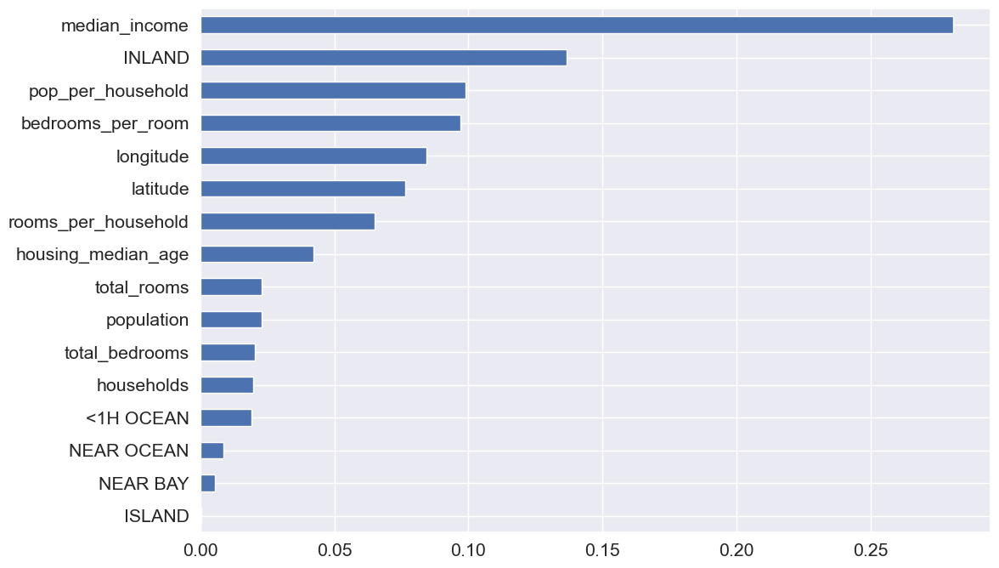

In [179]:
feature_imp.sort_values().plot.barh(figsize=(12, 8))
plt.show()

### (10.4) Meaning and Use


Understanding feature importance is crucial for interpreting the model's decision-making process, simplifying the model by removing unimportant features, and focusing on the most influential factors for more targeted data collection and feature engineering. This insight can also be valuable for stakeholders to understand the driving factors behind housing prices in this context.